In [1]:
import pandas as pd
import data_cleaning_functions as mylib
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
import numpy as np
import folium
from scipy.spatial import KDTree

dataset_path = 'data/merged_records.csv'
raw_data = pd.read_csv(dataset_path)

raw_data.head()

,Incident Type,Year,Reported Month,Region of Origin,Region of Incident,Country of Origin,Number Dead,Minimum Estimated Number of Missing,Total Dead and Missing,Number of Survivors,...,Rounded_Lon,dataset,Unnamed: 0,Main ID,Incident ID,Incident Date,URL,Source Quality,Web ID,Reported Date
0,Incident,2014,1,Central America,North America,Guatemala,1.0,0.0,1,0.0,...,-110.366,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Incident,2014,1,Latin America / Caribbean (P),North America,Unknown,1.0,0.0,1,0.0,...,-111.738,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Incident,2014,1,Latin America / Caribbean (P),North America,Unknown,1.0,0.0,1,0.0,...,-113.011,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Incident,2014,1,Central America,North America,Mexico,1.0,0.0,1,0.0,...,-109.316,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Incident,2014,1,Northern Africa,Europe,Sudan,1.0,0.0,1,2.0,...,28.000,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [2]:
# help(mylib)

In [3]:
mylib.data_analysis_report(raw_data)

INFO:root:Removing rows with missing values (NaN)...
INFO:root:Rows with missing values (NaN) removed.


,columns,count,issue,recommendation
Non-Snake Case Columns,"[Incident Type, Year, Reported Month, Region o...",31,Column labels are not in snake_case format,Rename columns to snake_case format: Incident ...
Missing Values,"[Incident Type, Region of Origin, Country of O...","{'Incident Type': 3012, 'Year': 0, 'Reported M...",Missing values found in the dataset,Remove or impute missing values
Outliers Detected,"[Number Dead, Minimum Estimated Number of Miss...",9,Outliers detected in the dataset,"Handle outliers appropriately (e.g., remove or..."
Incorrect Data Types,"{'Year': <class 'int'>, 'Reported Month': <cla...",17,Inconsistent or incorrect data types,Ensure data types are appropriate and consistent


In [4]:
raw_data

,Incident Type,Year,Reported Month,Region of Origin,Region of Incident,Country of Origin,Number Dead,Minimum Estimated Number of Missing,Total Dead and Missing,Number of Survivors,...,Rounded_Lon,dataset,Unnamed: 0,Main ID,Incident ID,Incident Date,URL,Source Quality,Web ID,Reported Date
0,Incident,2014,1,Central America,North America,Guatemala,1.0,0.0,1,0.0,...,-110.366,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Incident,2014,1,Latin America / Caribbean (P),North America,Unknown,1.0,0.0,1,0.0,...,-111.738,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Incident,2014,1,Latin America / Caribbean (P),North America,Unknown,1.0,0.0,1,0.0,...,-113.011,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Incident,2014,1,Central America,North America,Mexico,1.0,0.0,1,0.0,...,-109.316,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Incident,2014,1,Northern Africa,Europe,Sudan,1.0,0.0,1,2.0,...,28.000,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14189,NaN,2014,1,NaN,Europe,NaN,1.0,0.0,1,2.0,...,1.879,1,NaN,NaN,NaN,NaN,http://bit.ly/1icTIF9,4.0,39373.0,"January 30, 2014"
14190,NaN,2014,1,NaN,Mediterranean,NaN,12.0,NaN,12,NaN,...,27.158,1,NaN,NaN,NaN,NaN,http://bit.ly/2aMCwfg,1.0,39403.0,"January 19, 2014"
14191,NaN,2014,1,NaN,US-Mexico Border,NaN,1.0,NaN,1,NaN,...,-111.624,1,NaN,NaN,NaN,NaN,NaN,5.0,39258.0,"January 17, 2014"
14192,NaN,2014,1,NaN,US-Mexico Border,NaN,1.0,NaN,1,NaN,...,-109.545,1,NaN,NaN,NaN,NaN,http://bit.ly/1qfIw00,5.0,39207.0,"January 16, 2014"


## Step 1: Removing Duplicates

In [5]:
duplicate_rows = raw_data.duplicated().sum()

if duplicate_rows > 0:
    raw_data.drop_duplicates(inplace=True)

duplicate_rows

0

## Step 2: Snake case

In [6]:
raw_data = mylib.clean_column_names(raw_data)
raw_data

INFO:root:Cleaning column names...
INFO:root:Column names cleaned.


,incident_type,year,reported_month,region_of_origin,region_of_incident,country_of_origin,number_dead,minimum_estimated_number_of_missing,total_dead_and_missing,number_of_survivors,...,rounded_lon,dataset,unnamed_0,main_id,incident_id,incident_date,url,source_quality,web_id,reported_date
0,Incident,2014,1,Central America,North America,Guatemala,1.0,0.0,1,0.0,...,-110.366,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Incident,2014,1,Latin America / Caribbean (P),North America,Unknown,1.0,0.0,1,0.0,...,-111.738,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Incident,2014,1,Latin America / Caribbean (P),North America,Unknown,1.0,0.0,1,0.0,...,-113.011,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Incident,2014,1,Central America,North America,Mexico,1.0,0.0,1,0.0,...,-109.316,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Incident,2014,1,Northern Africa,Europe,Sudan,1.0,0.0,1,2.0,...,28.000,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14189,NaN,2014,1,NaN,Europe,NaN,1.0,0.0,1,2.0,...,1.879,1,NaN,NaN,NaN,NaN,http://bit.ly/1icTIF9,4.0,39373.0,"January 30, 2014"
14190,NaN,2014,1,NaN,Mediterranean,NaN,12.0,NaN,12,NaN,...,27.158,1,NaN,NaN,NaN,NaN,http://bit.ly/2aMCwfg,1.0,39403.0,"January 19, 2014"
14191,NaN,2014,1,NaN,US-Mexico Border,NaN,1.0,NaN,1,NaN,...,-111.624,1,NaN,NaN,NaN,NaN,NaN,5.0,39258.0,"January 17, 2014"
14192,NaN,2014,1,NaN,US-Mexico Border,NaN,1.0,NaN,1,NaN,...,-109.545,1,NaN,NaN,NaN,NaN,http://bit.ly/1qfIw00,5.0,39207.0,"January 16, 2014"


In [7]:
def print_unique_value_counts(df):
    categorical_columns = df.select_dtypes(include=['object']).columns
    
    for column in categorical_columns:
        unique_values = df[column].unique()
        unique_count = len(unique_values)
        print(f"Column: {column}\nUnique Values: {unique_count}\nValue Counts:")
        print(df[column].value_counts())
        print("-" * 50)

print_unique_value_counts(raw_data)

Column: incident_type
Unique Values: 5
Value Counts:
incident_type
Incident                   10839
Split Incident               256
Cumulative Incident           82
Incident,Split Incident        5
Name: count, dtype: int64
--------------------------------------------------
Column: region_of_origin
Unique Values: 34
Value Counts:
region_of_origin
Latin America / Caribbean (P)    2044
Unknown                          1551
Central America                  1503
Sub-Saharan Africa (P)           1246
Southern Asia                    1106
Eastern Africa (P)                970
Northern Africa                   436
Western Asia                      396
South America                     306
Caribbean                         269
Eastern Africa                    263
Western Africa                    216
Western / Southern Asia (P)       211
Sub-Saharan Africa                112
Northern Africa (P)               112
Mixed                             101
South-eastern Asia                 67
Sout

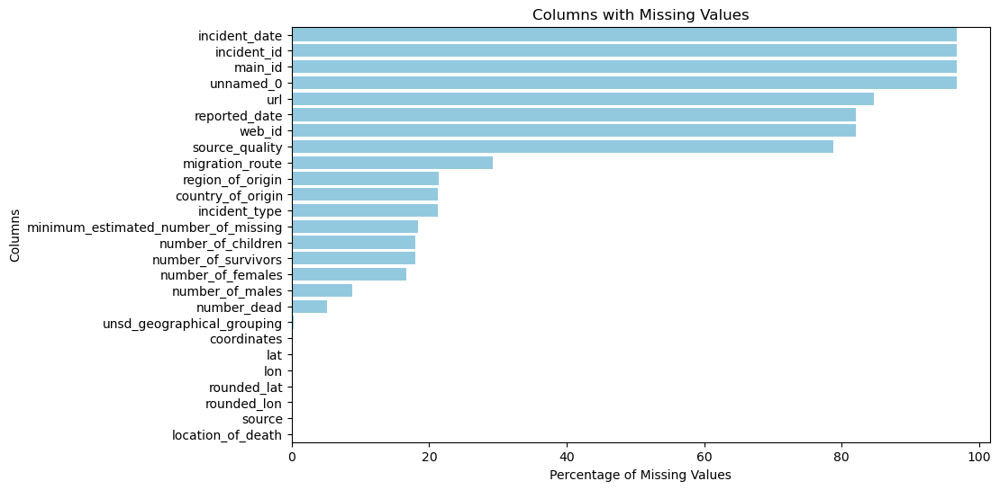

In [8]:
# This function calculates the percentage of missing values for each column, 
# filters out columns with no missing values, and then creates a horizontal 
# bar plot to visualize the columns with the most missing values.
def plot_missing_values(dataframe):
    # Calculate percentage of missing values for each column
    missing_percentages = (dataframe.isnull().sum() / len(dataframe)) * 100
    
    # Filter columns with missing values
    missing_columns = missing_percentages[missing_percentages > 0]
    
    # Sort columns by percentage of missing values in descending order
    missing_columns = missing_columns.sort_values(ascending=False)
    
    # Plot the missing values
    plt.figure(figsize=(10, 6))
    sns.barplot(x=missing_columns, y=missing_columns.index, color='skyblue')
    plt.xlabel('Percentage of Missing Values')
    plt.ylabel('Columns')
    plt.title('Columns with Missing Values')
    plt.show()

plot_missing_values(raw_data)


## Function for Plotting Columns with Missing Values

**What We Did:**
Created a function `plot_missing_values` that takes a DataFrame as an argument.
The function calculates the percentage of missing values for each column, filters out columns with no missing values, and sorts them in descending order.
It then plots these columns with their respective percentages of missing values.

**Why:**
To quickly visualize which columns in the DataFrame have the most missing values. This can aid in prioritizing data cleaning efforts and understanding the dataset's quality.



In [9]:
columns_to_remove = [
    'unnamed_0',
    'main_id',
    'incident_id',
    'incident_date',
    'url',
    'source_quality',
    'web_id',
    'reported_date',
    'rounded_lat',
    'rounded_lon',
    'incident_type'
]

raw_data = raw_data.drop(columns_to_remove, axis = 1)
raw_data

,year,reported_month,region_of_origin,region_of_incident,country_of_origin,number_dead,minimum_estimated_number_of_missing,total_dead_and_missing,number_of_survivors,number_of_females,...,number_of_children,cause_of_death,migration_route,location_of_death,source,coordinates,unsd_geographical_grouping,lat,lon,dataset
0,2014,1,Central America,North America,Guatemala,1.0,0.0,1,0.0,0.0,...,0.0,Mixed or unknown,US-Mexico border crossing,Pima Country Office of the Medical Examiner ju...,Pima County Office of the Medical Examiner (PC...,"31.650259, -110.366453",Northern America,31.650259,-110.366453,3
1,2014,1,Latin America / Caribbean (P),North America,Unknown,1.0,0.0,1,0.0,0.0,...,0.0,Mixed or unknown,US-Mexico border crossing,Pima Country Office of the Medical Examiner ju...,Pima County Office of the Medical Examiner (PC...,"31.59713, -111.73756",Northern America,31.597130,-111.737560,3
2,2014,1,Latin America / Caribbean (P),North America,Unknown,1.0,0.0,1,0.0,0.0,...,0.0,Mixed or unknown,US-Mexico border crossing,Pima Country Office of the Medical Examiner ju...,Pima County Office of the Medical Examiner (PC...,"31.94026, -113.01125",Northern America,31.940260,-113.011250,3
3,2014,1,Central America,North America,Mexico,1.0,0.0,1,0.0,0.0,...,0.0,Violence,US-Mexico border crossing,"near Douglas, Arizona, USA","Ministry of Foreign Affairs Mexico, Pima Count...","31.506777, -109.315632",Northern America,31.506777,-109.315632,3
4,2014,1,Northern Africa,Europe,Sudan,1.0,0.0,1,2.0,0.0,...,0.0,Harsh environmental conditions / lack of adequ...,NaN,Border between Russia and Estonia,EUBusiness (Agence France-Presse),"59.1551, 28",Northern Europe,59.155100,28.000000,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14189,2014,1,NaN,Europe,NaN,1.0,0.0,1,2.0,NaN,...,1.0,Vehicle Accident,Calais to United Kingdom,France - Calais,Calais Migrant Solidarity,"50.935500000000, 1.878660000000",Western Europe,50.935500,1.878660,1
14190,2014,1,NaN,Mediterranean,NaN,12.0,NaN,12,NaN,9.0,...,3.0,Drowning,Eastern Mediterranean,Waters near Greece while being towed back to T...,European Council on Refugees and Exiles,"37.283200000000, 27.158200000000",Uncategorized,37.283200,27.158200,1
14191,2014,1,NaN,US-Mexico Border,NaN,1.0,NaN,1,NaN,NaN,...,NaN,Shot,Central America to US,Pima County,Pima County Office of the Medical Examiner,"32.058118300000, -111.623576100000",Northern America,32.058118,-111.623576,1
14192,2014,1,NaN,US-Mexico Border,NaN,1.0,NaN,1,NaN,NaN,...,NaN,Shot,Central America to US,"near Douglas, Arizona",Ministry of Foreign Affairs Mexico,"31.344700000000, -109.545000000000",Northern America,31.344700,-109.545000,1


In [10]:
raw_data.dtypes

year                                     int64
reported_month                           int64
region_of_origin                        object
region_of_incident                      object
country_of_origin                       object
number_dead                            float64
minimum_estimated_number_of_missing    float64
total_dead_and_missing                   int64
number_of_survivors                    float64
number_of_females                      float64
number_of_males                        float64
number_of_children                     float64
cause_of_death                          object
migration_route                         object
location_of_death                       object
source                                  object
coordinates                             object
unsd_geographical_grouping              object
lat                                    float64
lon                                    float64
dataset                                  int64
dtype: object

In [11]:
raw_data.isna().sum().T

year                                      0
reported_month                            0
region_of_origin                       3033
region_of_incident                        0
country_of_origin                      3020
number_dead                             723
minimum_estimated_number_of_missing    2607
total_dead_and_missing                    0
number_of_survivors                    2552
number_of_females                      2361
number_of_males                        1251
number_of_children                     2559
cause_of_death                            0
migration_route                        4149
location_of_death                         8
source                                   12
coordinates                              14
unsd_geographical_grouping               47
lat                                      14
lon                                      14
dataset                                   0
dtype: int64

In [12]:
categorical = raw_data.select_dtypes(include='object')
categorical

,region_of_origin,region_of_incident,country_of_origin,cause_of_death,migration_route,location_of_death,source,coordinates,unsd_geographical_grouping
0,Central America,North America,Guatemala,Mixed or unknown,US-Mexico border crossing,Pima Country Office of the Medical Examiner ju...,Pima County Office of the Medical Examiner (PC...,"31.650259, -110.366453",Northern America
1,Latin America / Caribbean (P),North America,Unknown,Mixed or unknown,US-Mexico border crossing,Pima Country Office of the Medical Examiner ju...,Pima County Office of the Medical Examiner (PC...,"31.59713, -111.73756",Northern America
2,Latin America / Caribbean (P),North America,Unknown,Mixed or unknown,US-Mexico border crossing,Pima Country Office of the Medical Examiner ju...,Pima County Office of the Medical Examiner (PC...,"31.94026, -113.01125",Northern America
3,Central America,North America,Mexico,Violence,US-Mexico border crossing,"near Douglas, Arizona, USA","Ministry of Foreign Affairs Mexico, Pima Count...","31.506777, -109.315632",Northern America
4,Northern Africa,Europe,Sudan,Harsh environmental conditions / lack of adequ...,NaN,Border between Russia and Estonia,EUBusiness (Agence France-Presse),"59.1551, 28",Northern Europe
...,...,...,...,...,...,...,...,...,...
14189,NaN,Europe,NaN,Vehicle Accident,Calais to United Kingdom,France - Calais,Calais Migrant Solidarity,"50.935500000000, 1.878660000000",Western Europe
14190,NaN,Mediterranean,NaN,Drowning,Eastern Mediterranean,Waters near Greece while being towed back to T...,European Council on Refugees and Exiles,"37.283200000000, 27.158200000000",Uncategorized
14191,NaN,US-Mexico Border,NaN,Shot,Central America to US,Pima County,Pima County Office of the Medical Examiner,"32.058118300000, -111.623576100000",Northern America
14192,NaN,US-Mexico Border,NaN,Shot,Central America to US,"near Douglas, Arizona",Ministry of Foreign Affairs Mexico,"31.344700000000, -109.545000000000",Northern America


## Data Transformation - Comparing Categorical Columns

### What:
- Display the unique values for the 'Region of Origin' and 'UNSD Geographical Grouping' columns.
- Compare the 'Region of Origin' and 'UNSD Geographical Grouping' columns for each row to see if the values are the same or different.

### Why:
- The purpose was to compare the categorization of regions in these two columns and assess whether they can be harmonized or if they serve different purposes.
- To assess if one of these columns is redundant and can be dropped, thereby simplifying the dataset.

In [13]:
region_of_origin_unique_values = raw_data['region_of_incident'].unique()
unsd_geographical_grouping_unique_values = raw_data['unsd_geographical_grouping'].unique()

region_of_origin_unique_values, unsd_geographical_grouping_unique_values

(array(['North America', 'Europe', 'Mediterranean', 'Caribbean',
        'Southeast Asia', 'South Asia', 'Eastern Africa',
        'Central America', 'North Africa', 'Eastern Asia', 'Western Asia',
        'Western Africa', 'South America', 'Southern Africa',
        'Middle Africa', 'Central Asia', 'Middle East', 'US-Mexico Border',
        'Sub-Saharan Africa', 'Horn of Africa'], dtype=object),
 array(['Northern America', 'Northern Europe', 'Uncategorized',
        'Western Europe', 'Caribbean', 'South-eastern Asia',
        'Southern Asia', 'Central America', 'Eastern Africa',
        'Northern Africa', 'Eastern Asia', 'Western Asia',
        'Eastern Europe', 'Southern Europe', 'Western Africa',
        'South America', 'Southern Africa', 'Middle Africa',
        'Central Asia', nan, 'South Asia', 'Central Africa'], dtype=object))

In [14]:
region_comparison = raw_data['region_of_incident'] == raw_data['unsd_geographical_grouping']

# Count the number of rows where the two regions are the same and where they are different
region_comparison_counts = region_comparison.value_counts()

# Display the comparison counts
region_comparison_counts

False    10887
True      3307
Name: count, dtype: int64

### Outcome:
- The 'Region of Origin' column contains 34 unique values, including variations with '(P)' and 'Unknown'.
- The 'UNSD Geographical Grouping' column contains 22 unique values, including 'Uncategorized'.
- The two columns are the same in 2,046 rows.
- The two columns are different in 12,148 rows.

### Observations:
- The 'Region of Origin' column provides more granularity, with specific regions identified, sometimes with variations marked by '(P)'.
- The 'UNSD Geographical Grouping' column appears to be more standardized, but it has fewer unique values, indicating potential less granularity.
- Both columns seem to serve similar yet distinct purposes. 'Region of Origin' is more specific, while 'UNSD Geographical Grouping' is more standardized.
- In the majority of cases (12,148 rows), the two columns are not the same, indicating that they likely serve different purposes or levels of granularity.
- Only in 2,046 rows are the values the same, which is a minority of the cases.

#### Given these results, it doesn't seem advisable to drop either column, as they appear to provide different information.


## Checking 1x1 Mapping Between 'Region of Incident' and 'UNSD Geographical Grouping'

### What:
Check if there is a 1x1 mapping between the 'Region of Incident' and 'UNSD Geographical Grouping' columns, excluding NaN values.

### Why:
The purpose was to determine if the two columns are directly interchangeable, which would allow us to potentially simplify the dataset by removing one of them.


In [15]:
inference_check = raw_data.groupby('region_of_incident')['unsd_geographical_grouping'].nunique()

# Display the number of unique 'unsd_geographical_grouping' for each 'region_of_incident'
inference_check

region_of_incident
Caribbean             5
Central America       5
Central Asia          1
Eastern Africa        5
Eastern Asia          1
Europe                6
Horn of Africa        4
Mediterranean         5
Middle Africa         1
Middle East           3
North Africa          5
North America         4
South America         3
South Asia            5
Southeast Asia        5
Southern Africa       3
Sub-Saharan Africa    7
US-Mexico Border      6
Western Africa        3
Western Asia          3
Name: unsd_geographical_grouping, dtype: int64

In [16]:
inference_check_reverse = raw_data.groupby('unsd_geographical_grouping')['region_of_incident'].nunique()

inference_check_reverse

unsd_geographical_grouping
Caribbean              1
Central Africa         1
Central America        5
Central Asia           2
Eastern Africa         6
Eastern Asia           3
Eastern Europe         2
Middle Africa          1
Northern Africa        8
Northern America       4
Northern Europe        2
South America          4
South Asia             2
South-eastern Asia     2
Southern Africa        2
Southern Asia          2
Southern Europe        4
Uncategorized         16
Western Africa         3
Western Asia           7
Western Europe         3
Name: region_of_incident, dtype: int64

In [17]:
pivot_table_region_unsd = pd.pivot_table(raw_data, index='region_of_incident', columns='unsd_geographical_grouping', 
                                         values='year', aggfunc='count', fill_value=0)
pivot_table_region_unsd

unsd_geographical_grouping,Caribbean,Central Africa,Central America,Central Asia,Eastern Africa,Eastern Asia,Eastern Europe,Middle Africa,Northern Africa,Northern America,...,South America,South Asia,South-eastern Asia,Southern Africa,Southern Asia,Southern Europe,Uncategorized,Western Africa,Western Asia,Western Europe
region_of_incident,,,,,,,,,,,,,,,,,,,,,
Caribbean,125,0,2,0,0,0,0,0,0,1,...,2,0,0,0,0,0,52,0,0,0
Central America,0,0,1327,1,0,0,0,0,0,16,...,1,0,0,0,0,0,6,0,0,0
Central Asia,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Eastern Africa,0,0,0,0,418,3,0,0,1,0,...,0,0,0,0,0,0,16,0,1,0
Eastern Asia,0,0,0,0,0,12,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Europe,0,0,0,0,0,0,111,0,0,0,...,0,0,0,0,0,334,19,0,2,164
Horn of Africa,0,0,0,0,169,0,0,0,17,0,...,0,0,0,0,0,0,12,0,12,0
Mediterranean,0,0,0,0,0,0,1,0,17,0,...,0,0,0,0,0,10,2265,0,2,0
Middle Africa,0,0,0,0,0,0,0,69,0,0,...,0,0,0,0,0,0,0,0,0,0



### Outcome:
Both columns do not have unique values when paired, indicating that there is not a 1x1 mapping between the two.

### Observations:
Since neither column has unique values, it suggests that multiple 'Region of Incident' values can correspond to a single 'UNSD Geographical Grouping' value, and vice versa.

Therefore, the two columns are not directly interchangeable and serve different categorization purposes.

Since there is no 1x1 mapping, it would not be advisable to remove either column based on this criterion.


In [18]:
raw_data[raw_data['unsd_geographical_grouping'].isna()]['region_of_incident'].value_counts()

region_of_incident
Southeast Asia        30
South Asia             6
US-Mexico Border       5
Caribbean              2
North America          1
Sub-Saharan Africa     1
South America          1
Mediterranean          1
Name: count, dtype: int64

## Observations

The missing 'UNSD Geographical Grouping' values are not concentrated in a single 'Region of Incident', and they are spread across different regions.

Given that each of these 'Region of Incident' values could correspond to multiple 'UNSD Geographical Grouping' values (as seen earlier), it may not be straightforward to accurately impute the missing 'UNSD Geographical Grouping' values.


## Imputing Missing 'UNSD Geographical Grouping' Values

### What:
Apply the `set_unsd_from_region` Function to the `raw_data` DataFrame Using the Provided Mapping.

### Why:
To Impute Missing Values in the 'UNSD Geographical Grouping' Column Based on the 'Region of Incident'.

In [19]:
# Define a function to set NaN values for 'unsd_geographical_grouping' based on a provided mapping
def set_unsd_from_region(df, mapping_dict):
    # Create a copy of the DataFrame to avoid modifying the original
    df_copy = df.copy()
    
    # Loop through each mapping and update 'unsd_geographical_grouping' where it's NaN
    for region, unsd_group in mapping_dict.items():
        mask = (df_copy['region_of_incident'] == region) & (df_copy['unsd_geographical_grouping'].isna())
        df_copy.loc[mask, 'unsd_geographical_grouping'] = unsd_group
        
    return df_copy

region_mapping = {
    'Southeast Asia': 'South-eastern Asia',
    'South Asia': 'Southern Asia',
    'North America': 'Northern America',
    'US-Mexico Border': 'Northern America', 
    'Caribbean': 'Caribbean',             
    'North America': 'Northern America',
    'Sub-Saharan Africa': 'Western Africa',
    'South America' :  'South America',       
    'Mediterranean' : 'Uncategorized',
    'Middle Africa': 'Central Africa'
}
raw_data = set_unsd_from_region(raw_data, region_mapping)
raw_data['unsd_geographical_grouping'] = raw_data['unsd_geographical_grouping'].replace(region_mapping)


raw_data['unsd_geographical_grouping'].isna().sum()

0

In [20]:
raw_data['unsd_geographical_grouping'].value_counts()

unsd_geographical_grouping
Northern America      3459
Uncategorized         2663
Northern Africa       1870
Central America       1582
Western Africa        1113
Southern Asia          906
Eastern Africa         697
Western Asia           554
Southern Europe        347
South-eastern Asia     242
South America          207
Western Europe         166
Caribbean              127
Eastern Europe         112
Central Africa          82
Northern Europe         30
Southern Africa         18
Eastern Asia            17
Central Asia             2
Name: count, dtype: int64

### Outcome:
- Successfully Imputed All Missing 'UNSD Geographical Grouping' Values Based on the Mapping Provided for 'Region of Incident'.
- The Number of NaN Values in 'UNSD Geographical Grouping' is Now 0.
- The Dataset is Now More Complete, Facilitating Subsequent Analyses.


## Perform a complete analysis of the 'region_of_origin' and 'country_of_origin' columns

In [21]:
# Basic statistics: number of unique values, top value, frequency of top value
basic_stats_region = raw_data['region_of_origin'].describe()
basic_stats_country = raw_data['country_of_origin'].describe()

# Count of NaN values
nan_count_region = raw_data['region_of_origin'].isna().sum()
nan_count_country = raw_data['country_of_origin'].isna().sum()

# Value counts (top 10 for readability)
value_counts_region = raw_data['region_of_origin'].value_counts().head(10)
value_counts_country = raw_data['country_of_origin'].value_counts().head(10)

basic_stats_region, nan_count_region, value_counts_region, basic_stats_country, nan_count_country, value_counts_country

(count                             11161
 unique                               33
 top       Latin America / Caribbean (P)
 freq                               2044
 Name: region_of_origin, dtype: object,
 3033,
 region_of_origin
 Latin America / Caribbean (P)    2044
 Unknown                          1551
 Central America                  1503
 Sub-Saharan Africa (P)           1246
 Southern Asia                    1106
 Eastern Africa (P)                970
 Northern Africa                   436
 Western Asia                      396
 South America                     306
 Caribbean                         269
 Name: count, dtype: int64,
 count       11174
 unique        327
 top       Unknown
 freq         6370
 Name: country_of_origin, dtype: object,
 3020,
 country_of_origin
 Unknown                               6370
 Afghanistan                            926
 Mexico                                 689
 Honduras                               294
 Guatemala                        

## Complete Analysis of 'Region of Origin' and 'Country of Origin'

**What We Did:**
Performed a detailed analysis of both the 'Region of Origin' and 'Country of Origin' columns. This includes basic statistics, count of NaN values, and value counts for the top 10 regions and countries.

**Why:**
To understand the distribution, commonality, and gaps in both columns, which are crucial for geographical and origin-based analyses.

### 'Region of Origin'

**Basic Statistics:**

- Count: 11,161 non-null values
- Unique Values: 33 unique categories
- Most Frequent Category: 'Latin America / Caribbean (P)' (2,044 occurrences)

**Missing Values:**

- NaN Count: 3,033 missing values

**Top 10 Regions:**

1. Latin America / Caribbean (P): 2,044
2. Unknown: 1,551
3. Central America: 1,503
4. Sub-Saharan Africa (P): 1,246
5. Southern Asia: 1,106
6. Eastern Africa (P): 970
7. Northern Africa: 436
8. Western Asia: 396
9. South America: 306
10. Caribbean: 269

### 'Country of Origin'

**Basic Statistics:**

- Count: 11,174 non-null values
- Unique Values: 327 unique countries
- Most Frequent Category: 'Unknown' (6,370 occurrences)

**Missing Values:**

- NaN Count: 3,020 missing values

**Top 10 Countries:**

1. Unknown: 6,370
2. Afghanistan: 926
3. Mexico: 689
4. Honduras: 294
5. Guatemala: 287
6. Syrian Arab Republic: 284
7. Venezuela: 189
8. Ethiopia: 148
9. Morocco: 131
10. Algeria: 119

**Observations:**

- Both columns have a significant number of missing values ('Region of Origin' has 3,033 and 'Country of Origin' has 3,020).
- The category 'Unknown' has a high frequency in both columns, especially in 'Country of Origin' with 6,370 occurrences.
- 'Region of Origin' has fewer unique categories (33) compared to 'Country of Origin' (327), indicating different levels of granularity.


In [22]:
# Filter the rows where 'region_of_origin' contains '(P)'
region_with_p = raw_data[raw_data['region_of_origin'].str.contains('\(P\)', na=False)]

# Check how many of these rows have 'country_of_origin' as NaN
country_na_when_region_with_p = region_with_p['country_of_origin'].isna().sum()

# Total number of rows where 'region_of_origin' contains '(P)'
total_region_with_p = len(region_with_p)

# Percentage of rows with '(P)' in 'region_of_origin' that have a non-empty 'country_of_origin'
percentage_non_empty_country = ((total_region_with_p - country_na_when_region_with_p) / total_region_with_p) * 100

total_region_with_p, country_na_when_region_with_p, percentage_non_empty_country

(4733, 2, 99.9577435030636)

## Hypothesis Testing: Presence of '(P)' in 'Region of Origin' and Non-Empty 'Country of Origin'

**Hypothesis:**
If there is '(P)' in the 'Region of Origin', then 'Country of Origin' is not empty.

**What We Did:**
1. Filtered the rows where 'Region of Origin' contains '(P)'.
2. Checked how many of these rows have 'Country of Origin' as NaN.

**Outcome:**
- Total number of rows where 'Region of Origin' contains '(P)': 4,733
- Number of these rows where 'Country of Origin' is NaN: 2
- Percentage of rows with '(P)' in 'Region of Origin' that have a non-empty 'Country of Origin': ~99.96%

**Conclusion:**
The hypothesis seems to be strongly supported by the data. Almost all (99.96%) of the records that have '(P)' in the 'Region of Origin' also have a non-empty 'Country of Origin'.

Given this, it's reasonable to conclude that the presence of '(P)' in 'Region of Origin' is a strong indicator that 'Country of Origin' will not be empty.


In [23]:
# Filter the rows where 'region_of_origin' is NaN
region_na = raw_data[raw_data['region_of_origin'].isna()]

# Check how many of these rows have 'country_of_origin' as NaN
country_na_when_region_na = region_na['country_of_origin'].isna().sum()

# Total number of rows where 'region_of_origin' is NaN
total_region_na = len(region_na)

# Percentage of rows with NaN in 'region_of_origin' that also have NaN in 'country_of_origin'
percentage_both_na = (country_na_when_region_na / total_region_na) * 100

total_region_na, country_na_when_region_na, percentage_both_na

(3033, 3012, 99.30761622156281)

## Analysis: Empty 'Country of Origin' Among Rows with Empty 'Region of Origin'

**What We Did:**
1. Filtered the rows where 'Region of Origin' is NaN.
2. Checked how many of these rows also have 'Country of Origin' as NaN.

**Outcome:**
- Total number of rows where 'Region of Origin' is NaN: 3,033
- Number of these rows where 'Country of Origin' is also NaN: 3,012
- Percentage of rows with NaN in 'Region of Origin' that also have NaN in 'Country of Origin': ~99.31%

**Conclusion:**
A significant majority (~99.31%) of the records that have an empty 'Region of Origin' also have an empty 'Country of Origin'. This suggests a strong correlation between missing values in these two columns.


In [24]:
raw_data[raw_data['region_of_origin'].isna()]['dataset'].value_counts()

dataset
1    2546
2     466
3      21
Name: count, dtype: int64

## Analysis: Dataset Distribution for Rows with Empty 'Region of Origin'

**What We Did:**
- Checked the distribution of the 'dataset' column for rows where 'Region of Origin' is NaN.

**Outcome:**
The distribution of 'dataset' for rows with NaN in 'Region of Origin' is as follows:
- Dataset 1: 2,546 occurrences
- Dataset 2: 466 occurrences
- Dataset 3: 21 occurrences

**Observations:**
- A significant number of missing values for 'Region of Origin' come from Dataset 1 and Dataset 2.
- Only a small number of missing values for 'Region of Origin' are from Dataset 3.
- This could imply that the quality or completeness of data varies between these datasets, particularly regarding the 'Region of Origin' column.


In [25]:
# Perform a complete analysis of the 'migration_route' column

# Basic statistics: number of unique routes, top route, frequency of top route
basic_stats_route = raw_data['migration_route'].describe()

# Count of NaN values
nan_count_route = raw_data['migration_route'].isna().sum()

# Value counts (top 10 for readability)
value_counts_route = raw_data['migration_route'].value_counts().head(10)

basic_stats_route, nan_count_route, value_counts_route


(count                         10045
 unique                           34
 top       US-Mexico border crossing
 freq                           3265
 Name: migration_route, dtype: object,
 4149,
 migration_route
 US-Mexico border crossing                                3265
 Sahara Desert crossing                                   1677
 Central Mediterranean                                    1276
 Central America to US                                     923
 Western Mediterranean                                     681
 Afghanistan to Iran                                       442
 Eastern Mediterranean                                     342
 Western Africa / Atlantic route to the Canary Islands     248
 Western Balkans                                           220
 Türkiye-Europe land route                                 149
 Name: count, dtype: int64)

## Analysis of 'Migration Route'

**What We Did:**
Performed a detailed analysis of the 'Migration Route' column, including basic statistics, count of NaN values, and value counts for the top 10 routes.

**Why:**
To understand the distribution, commonality, and gaps in the 'Migration Route' data, which is crucial for any geographical or route-based analysis.

**Outcome:**

**Basic Statistics:**

- Count: 10,045 non-null values
- Unique Routes: 34 unique migration routes
- Most Frequent Route: 'US-Mexico border crossing' appears 3,265 times

**Missing Values:**

- NaN Count: 4,149 missing values

**Top 10 Migration Routes:**

1. US-Mexico border crossing: 3,265 occurrences
2. Sahara Desert crossing: 1,677 occurrences
3. Central Mediterranean: 1,276 occurrences
4. Central America to US: 923 occurrences
5. Western Mediterranean: 681 occurrences
6. Afghanistan to Iran: 442 occurrences
7. Eastern Mediterranean: 342 occurrences
8. Western Africa / Atlantic route to the Canary Islands: 248 occurrences
9. Western Balkans: 220 occurrences
10. Türkiye-Europe land route: 149 occurrences

**Observations:**

- The 'Migration Route' column is mostly populated but has a significant number of missing values (4,149).
- There are a variety of unique routes, but the most frequent one is the 'US-Mexico border crossing'.


## Filling NaN Values Based on Other Columns (e.g., Latitude and Longitude)

**What We Can Do:**

1. **Geographical Inference:** Use latitude and longitude to infer missing values in columns like 'Region of Incident', 'Region of Origin', and 'Migration Route'.

2. **Statistical Methods:** Use methods like regression, k-NN, or decision trees where the target variable would be the column with missing values, and predictor variables would be other relevant columns.

3. **Text-based Inference:** Use text data in other columns (e.g., 'Location Description') to fill missing values.

**Why:**
To improve the dataset's completeness and make it more useful for analysis.

**How:**

1. **Geographical Inference:** For missing 'Region' or 'Route', we can use geospatial libraries to match latitude and longitude to known regions or routes.

2. **Statistical Methods:** Use scikit-learn or similar libraries to create models that predict missing values based on other columns.

3. **Text-based Inference:** Use text processing libraries to parse location descriptions and fill missing values.


In [26]:
# Define the mapping of migration routes
migration_route_mapping = {
    'Calais to United Kingdom': 'English Channel to the UK',
    'Darien': 'Darien Gap',
    'Türkiye-Europe land route': 'Turkey-Europe land route',
    'Iran to Türkiye': 'Iran to Turkey',
    'Western Africa / Atlantic route to the Canary Islands': 'Western African',
    'US-Mexico border crossing': 'Central America to US',
    'Horn of Africa to Yemen crossing': 'Horn Africa to Yemen',
    'Caribbean to US': 'Cuba to US',
    'Cuba to US': 'Caribbean to US'
}

# Apply the mapping to the migration route column in the dataset
raw_data['migration_route'].replace(migration_route_mapping, inplace=True)
raw_data['migration_route'].value_counts()

migration_route
Central America to US                           4188
Sahara Desert crossing                          1677
Central Mediterranean                           1276
Western Mediterranean                            681
Afghanistan to Iran                              442
Eastern Mediterranean                            342
Western African                                  263
Western Balkans                                  220
Horn Africa to Yemen                             163
Turkey-Europe land route                         159
English Channel to the UK                        136
Syria to Türkiye                                 116
Darien Gap                                        89
Cuba to US                                        63
Belarus-EU border                                 61
Dominican Republic to Puerto Rico                 42
Iran to Turkey                                    34
Italy to France                                   34
Haiti to Dominican Republic   

In [27]:
# List of migration routes to be dropped
routes_to_drop = [
    'DRC to Uganda',
    'Caribbean to US',
    'Central Mediterranean,Sahara Desert crossing',
    'Caribbean to Central America',
    'Venezuela to Curaçao'
]

# Create a boolean mask for rows to be dropped
rows_to_drop_mask = raw_data['migration_route'].isin(routes_to_drop)

# Drop the rows using the boolean mask
raw_data.drop(raw_data[rows_to_drop_mask].index, inplace=True)

raw_data.shape

(14186, 21)

/Users/lilitdavidyan/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


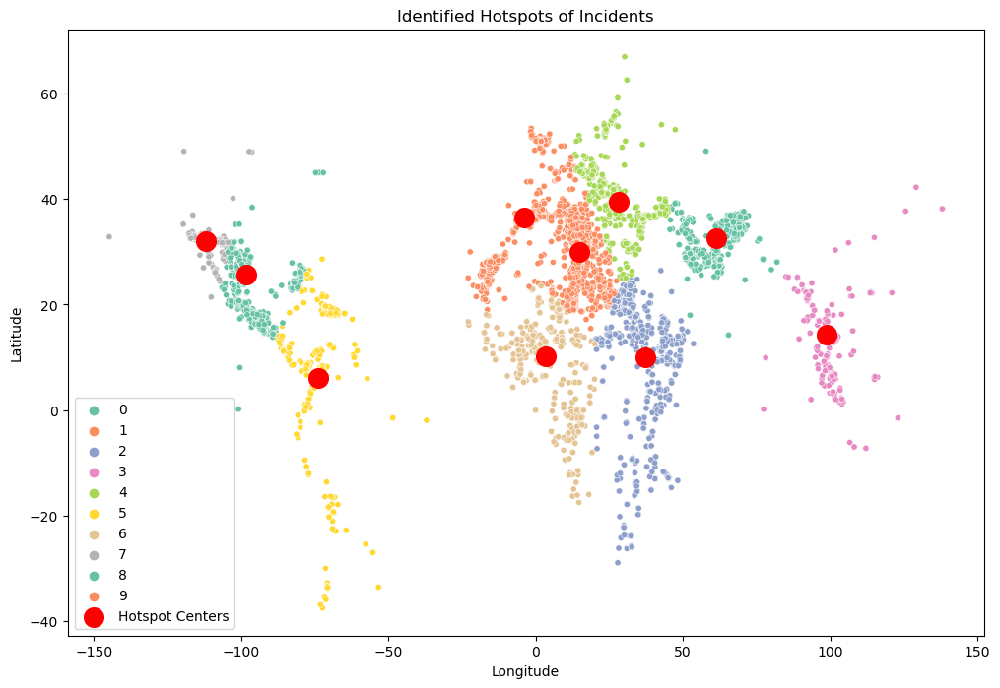

array([[  25.70268108,  -98.18997051],
       [  29.90085172,   14.71937417],
       [  10.07784702,   37.21759622],
       [  14.22998638,   98.67894115],
       [  39.5525636 ,   28.37795895],
       [   6.03236328,  -73.98524359],
       [  10.22134984,    3.29770013],
       [  32.02749135, -112.0677905 ],
       [  32.57847856,   61.18692206],
       [  36.45878226,   -4.05308254]])

In [28]:

# Remove missing values to prepare for clustering
lat_lon_data = raw_data[['lat', 'lon']].dropna()

# Using KMeans clustering to identify hotspots
# We will start with 10 clusters 
kmeans = KMeans(n_clusters=10, random_state=0).fit(lat_lon_data)

# Get the cluster centers (hotspots)
hotspots = kmeans.cluster_centers_

# Add cluster labels to the original data for visualization
lat_lon_data['Cluster'] = kmeans.labels_

# Plot the data points and cluster centers
plt.figure(figsize=(12, 8))
sns.scatterplot(data=lat_lon_data, x='lon', y='lat', hue='Cluster', palette='Set2', s=20)
plt.scatter(hotspots[:, 1], hotspots[:, 0], s=200, c='red', label='Hotspot Centers')
plt.title('Identified Hotspots of Incidents')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()
plt.show()

hotspots


In [29]:
# # Remove missing values to prepare for clustering based on migration routes
# route_lat_lon_data = raw_data[['lat', 'lon', 'migration_route']].dropna()

# # Initialize an empty dictionary to store the hotspots for each migration route
# hotspots_by_route = {}

# # Loop through each unique migration route
# for route in route_lat_lon_data['migration_route'].unique():
#     # Extract the data for the current route
#     route_data = route_lat_lon_data[route_lat_lon_data['migration_route'] == route][['lat', 'lon']]
    
#     # Determine the number of clusters based on the number of samples
#     n_clusters = min(3, len(route_data))  # Use 3 clusters or fewer if not enough samples
    
#     # Skip clustering if only one sample
#     if n_clusters < 2:
#         continue
    
#     # Perform KMeans clustering
#     kmeans = KMeans(n_clusters=n_clusters, random_state=0, n_init=10).fit(route_data)
    
#     # Store the cluster centers (hotspots) in the dictionary
#     hotspots_by_route[route] = kmeans.cluster_centers_
    
#     # Add cluster labels to the original data for visualization
#     route_data['Cluster'] = kmeans.labels_
    
#     # Plot the data points and cluster centers
#     plt.figure(figsize=(12, 8))
#     sns.scatterplot(data=route_data, x='lon', y='lat', hue='Cluster', palette='Set2', s=20)
#     plt.scatter(hotspots_by_route[route][:, 1], hotspots_by_route[route][:, 0], s=200, c='red', label='Hotspot Centers')
#     plt.title(f'Identified Hotspots for {route}')
#     plt.xlabel('Longitude')
#     plt.ylabel('Latitude')
#     plt.legend()
#     plt.show()

In [30]:
# Remove missing values to prepare for clustering based on migration routes
route_lat_lon_data = raw_data[['lat', 'lon', 'migration_route']].dropna()

# Initialize an empty dictionary to store the single center for each migration route
centers_by_route = {}

# Loop through each unique migration route to find the center
for route in route_lat_lon_data['migration_route'].unique():
    route_data = route_lat_lon_data[route_lat_lon_data['migration_route'] == route][['lat', 'lon']]
    if len(route_data) < 2:
        continue
    kmeans = KMeans(n_clusters=1, random_state=0, n_init=10).fit(route_data)
    centers_by_route[route] = kmeans.cluster_centers_[0]

# Replace NaN lat, lon with the center of the corresponding migration route
for i, row in raw_data.iterrows():
    if pd.isna(row['lon']) and row['migration_route'] in centers_by_route:
        center = centers_by_route[row['migration_route']]
        raw_data.at[i, 'lat'] = center[0]
        raw_data.at[i, 'lon'] = center[1]

# Drop the record that doesn't have a migration route
raw_data = raw_data.dropna(subset=['migration_route', 'lon'], how='all')


In [31]:
# Create a 'coordinates' column that combines 'lat' and 'lon' into a tuple
raw_data['coordinates'] = list(zip(raw_data['lat'], raw_data['lon']))

# Verify that the 'coordinates' column has been created
print(raw_data['coordinates'].head())

0    (31.650259, -110.366453)
1      (31.59713, -111.73756)
2      (31.94026, -113.01125)
3    (31.506777, -109.315632)
4             (59.1551, 28.0)
Name: coordinates, dtype: object


In [32]:
raw_data.isna().sum()

year                                      0
reported_month                            0
region_of_origin                       3029
region_of_incident                        0
country_of_origin                      3016
number_dead                             721
minimum_estimated_number_of_missing    2605
total_dead_and_missing                    0
number_of_survivors                    2549
number_of_females                      2359
number_of_males                        1249
number_of_children                     2556
cause_of_death                            0
migration_route                        4148
location_of_death                         8
source                                   12
coordinates                               0
unsd_geographical_grouping                0
lat                                       0
lon                                       0
dataset                                   0
dtype: int64

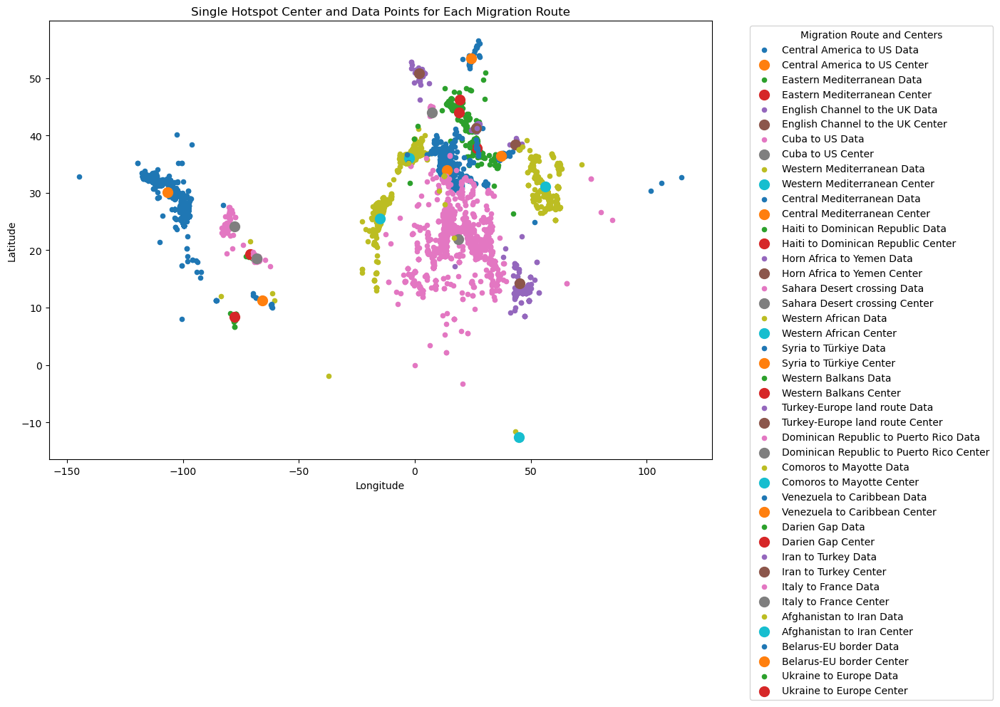

In [33]:


# Initialize an empty dictionary to store the single hotspot for each migration route
hotspot_by_route = {}

# Initialize the plot
plt.figure(figsize=(12, 8))

# Loop through each unique migration route
for route in route_lat_lon_data['migration_route'].unique():
    # Extract the data for the current route
    route_data = route_lat_lon_data[route_lat_lon_data['migration_route'] == route][['lat', 'lon']]
    
    # Skip if only one sample
    if len(route_data) < 2:
        continue
    
    # Perform KMeans clustering with n_clusters set to 1
    kmeans = KMeans(n_clusters=1, random_state=0, n_init=10).fit(route_data)
    
    # Store the cluster center (single hotspot) in the dictionary
    hotspot_by_route[route] = kmeans.cluster_centers_[0]
    
    # Plot the individual data points
    plt.scatter(route_data['lon'], route_data['lat'], label=f'{route} Data', s=20)
    
    # Plot the single cluster center
    plt.scatter(hotspot_by_route[route][1], hotspot_by_route[route][0], label=f'{route} Center', s=100)

# Finalize the plot
plt.title('Single Hotspot Center and Data Points for Each Migration Route')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(title='Migration Route and Centers', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

In [34]:

# Initialize a base map
m = folium.Map(location=[20, 0], zoom_start=3)

# Initialize a list to store center coordinates and route names
center_data = []

# Create a color map
colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']
color_map = {route: colors[i % len(colors)] for i, route in enumerate(route_lat_lon_data['migration_route'].unique())}

# Loop through each unique migration route
for route in route_lat_lon_data['migration_route'].unique():
    # Extract the data for the current route
    route_data = route_lat_lon_data[route_lat_lon_data['migration_route'] == route][['lat', 'lon']]
    
    # Skip if only one sample
    if len(route_data) < 2:
        continue
    
    # Perform KMeans clustering with n_clusters set to 1
    kmeans = KMeans(n_clusters=1, random_state=0, n_init=10).fit(route_data)
    
    # Store the cluster center (single hotspot) in the dictionary
    hotspot = kmeans.cluster_centers_[0]

    # Append center coordinates and route name to the list
    center_data.append({'migration_route': route, 'center_lat': hotspot[0], 'center_lon': hotspot[1]})

    # Get the color for this route from the color map
    route_color = color_map[route]
    
    # Plot individual data points on the map
    for i, row in route_data.iterrows():
        folium.CircleMarker(location=[row['lat'], row['lon']], radius=3, color=route_color, fill=True, fill_color=route_color).add_to(m)
    
    # Plot the single cluster center on the map
    folium.Marker(location=[hotspot[0], hotspot[1]], popup=f'{route} Center', icon=folium.Icon(color=route_color)).add_to(m)

# Show the map
m


In [35]:

center_df = pd.DataFrame(center_data)
center_df

,migration_route,center_lat,center_lon
0,Central America to US,30.112612,-106.570759
1,Eastern Mediterranean,37.752757,26.749898
2,English Channel to the UK,50.889544,1.895270
3,Cuba to US,24.179025,-77.685878
4,Western Mediterranean,36.030976,-2.595170
5,Central Mediterranean,33.937100,13.728402
6,Haiti to Dominican Republic,19.252004,-71.116455
7,Horn Africa to Yemen,14.186866,45.023169
8,Sahara Desert crossing,21.889114,18.870309
9,Western African,25.524704,-15.126015


In [36]:
# from scipy.spatial import KDTree

# # Create a KDTree from the center coordinates
# tree = KDTree(center_df[['center_lat', 'center_lon']])

# # Query the tree to find the closest pairs
# distances, indices = tree.query(center_df[['center_lat', 'center_lon']], k=2)

# # Find the unique distances and sort them
# unique_distances = sorted(set(distances[:, 1]))

# # Find the pairs with the top 10 minimum distances
# top_10_closest_route_pairs = []
# for dist in unique_distances[:10]:
#     dist_indices = [i for i, d in enumerate(distances[:, 1]) if d == dist]
#     for i in dist_indices:
#         closest_indices = indices[i]
#         top_10_closest_route_pairs.append((center_df.iloc[i]['migration_route'], center_df.iloc[closest_indices[1]]['migration_route']))

# # Print the top 10 closest route pairs and their minimum distances
# print("Top 10 Closest Route Pairs:")
# for i, route_pair in enumerate(top_10_closest_route_pairs):
#     print(f"{i+1}. {route_pair}")
#     print(f"   Minimum Distance: {unique_distances[i]}")


In [37]:
# migration_route_mapping = {}
# for route_pair in top_10_closest_route_pairs:
#     print(f"'{route_pair[0]}': '{route_pair[1]}'")


In [38]:
route_lat_lon_data['migration_route'].value_counts()

migration_route
Central America to US                4177
Sahara Desert crossing               1677
Central Mediterranean                1274
Western Mediterranean                 681
Afghanistan to Iran                   442
Eastern Mediterranean                 342
Western African                       263
Western Balkans                       220
Horn Africa to Yemen                  163
Turkey-Europe land route              159
English Channel to the UK             136
Syria to Türkiye                      116
Darien Gap                             89
Cuba to US                             63
Belarus-EU border                      61
Dominican Republic to Puerto Rico      42
Iran to Turkey                         34
Italy to France                        34
Haiti to Dominican Republic            16
Comoros to Mayotte                     15
Venezuela to Caribbean                 11
Ukraine to Europe                       9
Name: count, dtype: int64

In [39]:
# Initialize a base map
m = folium.Map(location=[20, 0], zoom_start=3)

# Filter data to include only rows where migration_route is NaN
no_route_data = raw_data[raw_data['migration_route'].isna()][['lat', 'lon']]

# Plot individual data points that don't have a migration route
for i, row in no_route_data.iterrows():
    folium.CircleMarker(location=[row['lat'], row['lon']], radius=3, color='black', fill=True, fill_color='black').add_to(m)

# Show the map
m

In [40]:
route_lat_lon_data['migration_route'].value_counts()

migration_route
Central America to US                4177
Sahara Desert crossing               1677
Central Mediterranean                1274
Western Mediterranean                 681
Afghanistan to Iran                   442
Eastern Mediterranean                 342
Western African                       263
Western Balkans                       220
Horn Africa to Yemen                  163
Turkey-Europe land route              159
English Channel to the UK             136
Syria to Türkiye                      116
Darien Gap                             89
Cuba to US                             63
Belarus-EU border                      61
Dominican Republic to Puerto Rico      42
Iran to Turkey                         34
Italy to France                        34
Haiti to Dominican Republic            16
Comoros to Mayotte                     15
Venezuela to Caribbean                 11
Ukraine to Europe                       9
Name: count, dtype: int64

In [41]:
raw_data[raw_data['migration_route'].isna()]['dataset'].value_counts()

dataset
3    2636
1    1446
2      66
Name: count, dtype: int64

In [42]:

# Initialize a base map
m = folium.Map(location=[20, 0], zoom_start=3)

# Filter data to include only rows where migration_route is NaN
no_route_data = raw_data[raw_data['migration_route'].isna()][['lat', 'lon']]

# Plot individual data points that don't have a migration route
for i, row in no_route_data.iterrows():
    folium.CircleMarker(location=[row['lat'], row['lon']], radius=3, color='black', fill=True, fill_color='black').add_to(m)

# Create a color map
colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']
color_map = {route: colors[i % len(colors)] for i, route in enumerate(route_lat_lon_data['migration_route'].unique())}

# Loop through each unique migration route
for route in route_lat_lon_data['migration_route'].unique():
    # Extract the data for the current route
    route_data = route_lat_lon_data[route_lat_lon_data['migration_route'] == route][['lat', 'lon']]
    
    # Skip if only one sample
    if len(route_data) < 2:
        continue
    
    # Perform KMeans clustering with n_clusters set to 1
    kmeans = KMeans(n_clusters=1, random_state=0, n_init=10).fit(route_data)
    
    # Store the cluster center (single hotspot) in the dictionary
    hotspot = kmeans.cluster_centers_[0]
    
    # Get the color for this route from the color map
    route_color = color_map[route]
    
    # Plot individual data points on the map
    for i, row in route_data.iterrows():
        folium.CircleMarker(location=[row['lat'], row['lon']], radius=3, color=route_color, fill=True, fill_color=route_color).add_to(m)
    
    # Plot the single cluster center on the map
    folium.Marker(location=[hotspot[0], hotspot[1]], popup=f'{route} Center', icon=folium.Icon(color=route_color)).add_to(m)


# Show the map
m


## Descriptive Statistics for Numerical Variables

In [43]:
def descriptive_stats(df, numerical_cols):
    # Compute descriptive statistics
    desc_stats = df[numerical_cols].describe().T
    
    print("Descriptive Statistics:")
    display(desc_stats)
    
    # Plot histograms for each numerical column
    for col in numerical_cols:
        sns.histplot(df[col], kde=True)
        plt.title(f'Histogram of {col}')
        plt.xlabel(col)
        plt.ylabel('Frequency')
        plt.show()

Descriptive Statistics:


,count,mean,std,min,25%,50%,75%,max
year,14185.0,2018.692845,2.388057,2014.0,2017.0,2019.0,2021.0,2023.0
reported_month,14185.0,6.726049,3.319445,1.0,4.0,7.0,10.0,12.0
number_dead,13464.0,2.834967,9.960351,0.0,1.0,1.0,2.0,750.0
minimum_estimated_number_of_missing,11580.0,2.787910,20.309151,-9.0,0.0,0.0,0.0,750.0
total_dead_and_missing,14185.0,4.966796,22.079273,0.0,1.0,1.0,2.0,1022.0
number_of_survivors,11636.0,8.351495,45.784507,-2.0,0.0,0.0,0.0,1950.0
number_of_females,11826.0,0.547438,3.091800,0.0,0.0,0.0,0.0,94.0
number_of_males,12936.0,1.222557,3.957391,0.0,0.0,1.0,1.0,135.0
number_of_children,11629.0,0.321610,4.176914,0.0,0.0,0.0,0.0,250.0


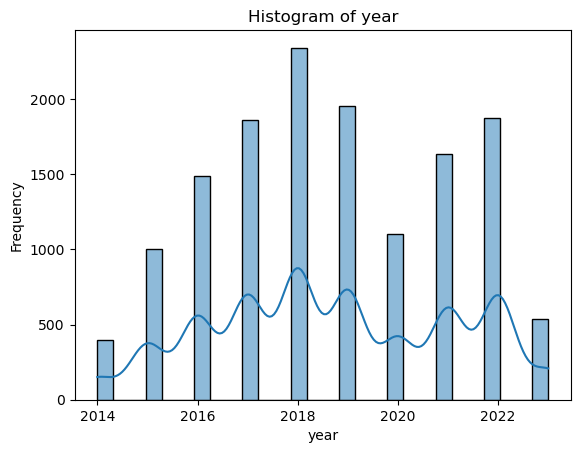

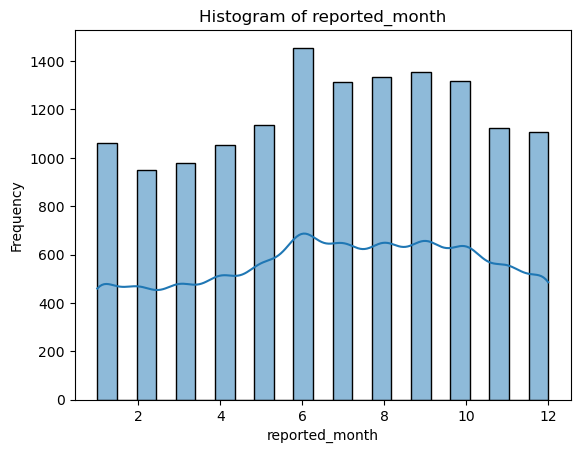

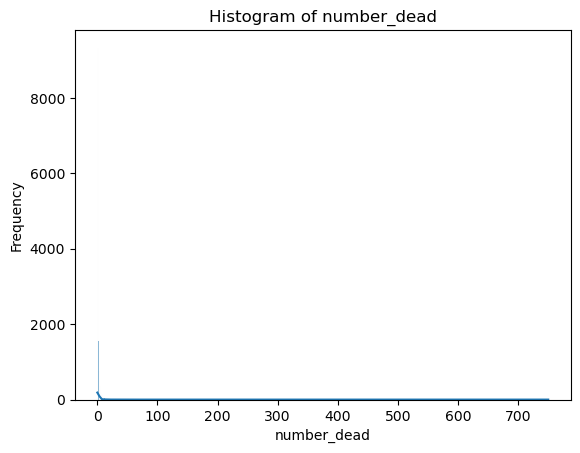

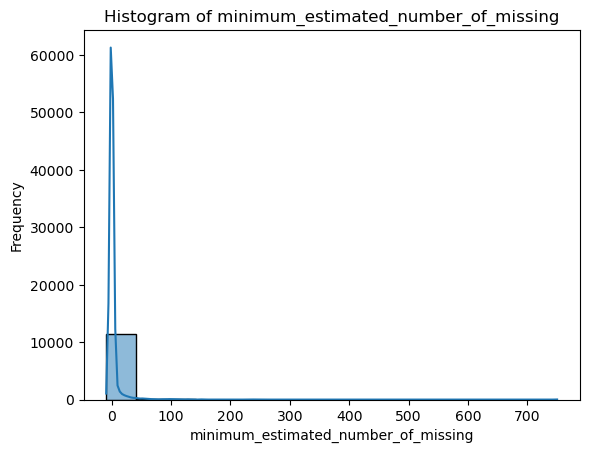

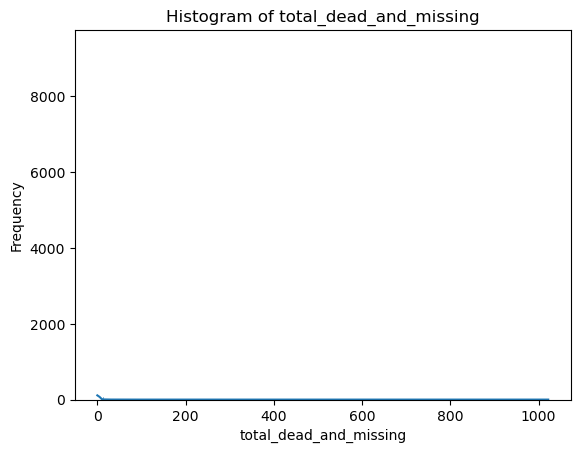

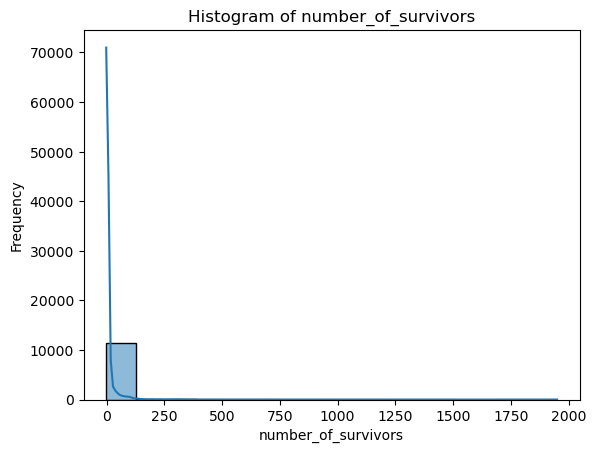

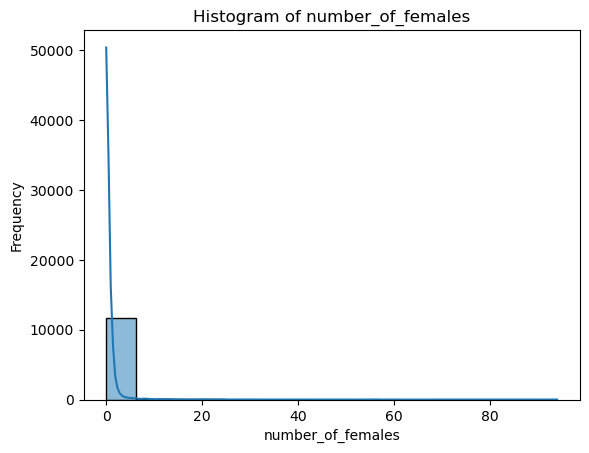

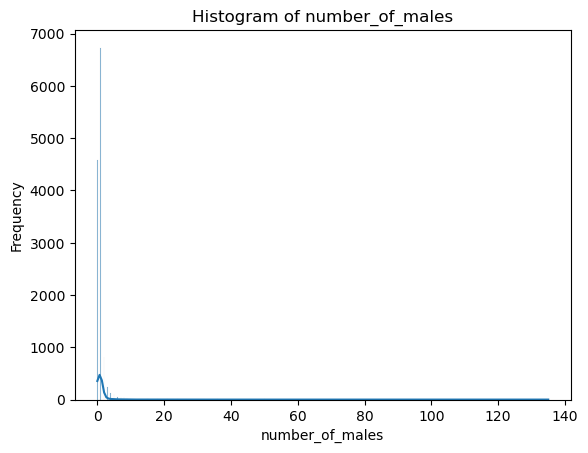

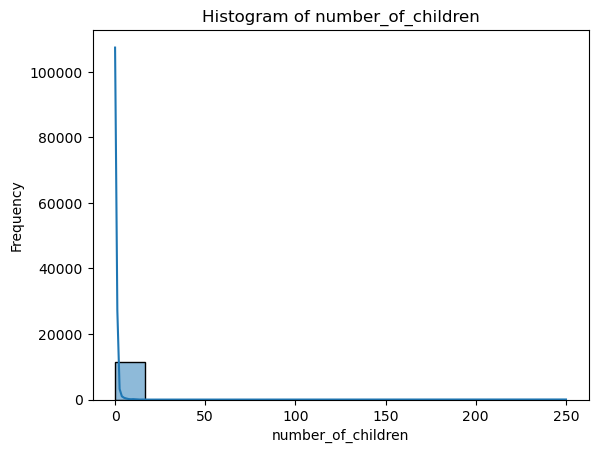

In [44]:
describe_cols=[
    'year', 'reported_month', 
    'number_dead', 'minimum_estimated_number_of_missing', 
    'total_dead_and_missing', 'number_of_survivors',
    'number_of_females', 'number_of_males', 'number_of_children'
]
descriptive_stats(raw_data, describe_cols)


Descriptive Statistics:


,count,mean,std,min,25%,50%,75%,max
year,3016.0,2017.485743,1.652917,2014.0,2016.0,2018.0,2018.0,2021.0
reported_month,3016.0,6.984416,3.189965,1.0,5.0,7.0,10.0,12.0
number_dead,2817.0,3.256301,8.950165,0.0,1.0,1.0,2.0,251.0
minimum_estimated_number_of_missing,411.0,22.350365,61.655960,-9.0,1.0,4.0,21.0,750.0
total_dead_and_missing,3016.0,6.087202,25.623528,0.0,1.0,1.0,3.0,750.0
number_of_survivors,467.0,35.522484,70.875072,-1.0,3.0,11.0,37.0,661.0
number_of_females,657.0,2.348554,4.191888,0.0,1.0,1.0,2.0,48.0
number_of_males,1767.0,2.084890,5.369436,0.0,1.0,1.0,1.0,123.0
number_of_children,460.0,3.152174,16.592866,0.0,1.0,1.0,2.0,250.0


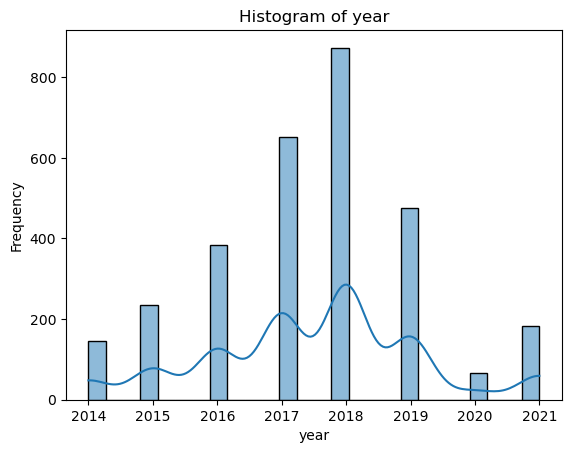

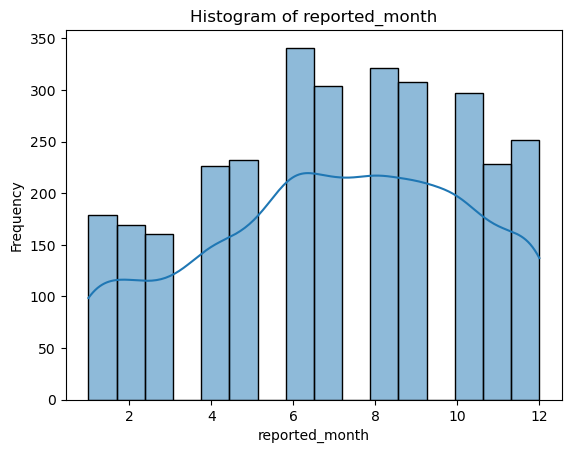

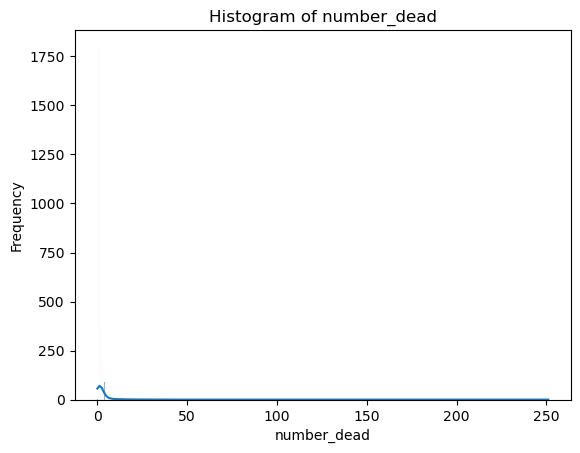

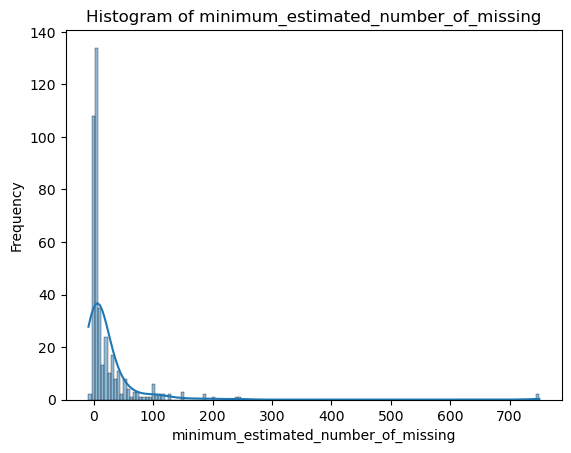

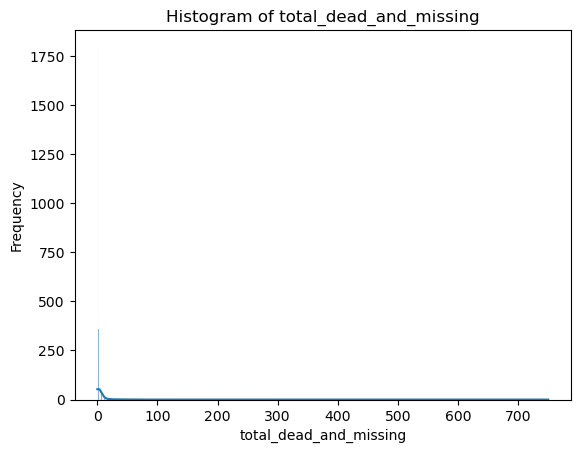

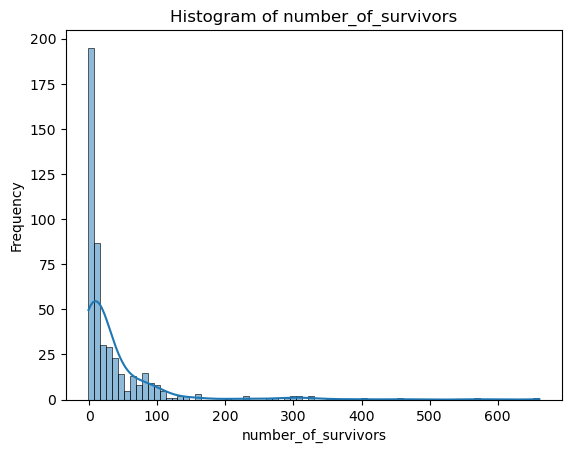

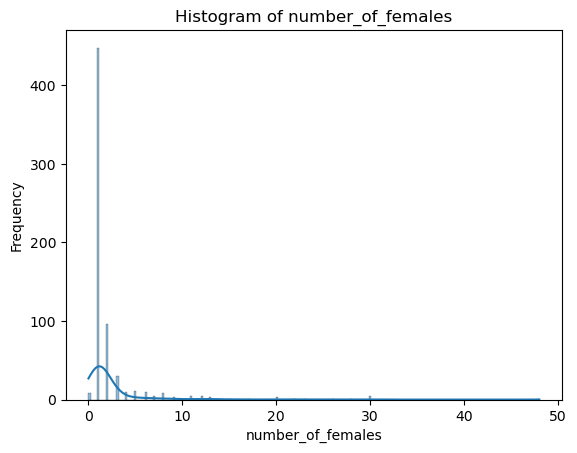

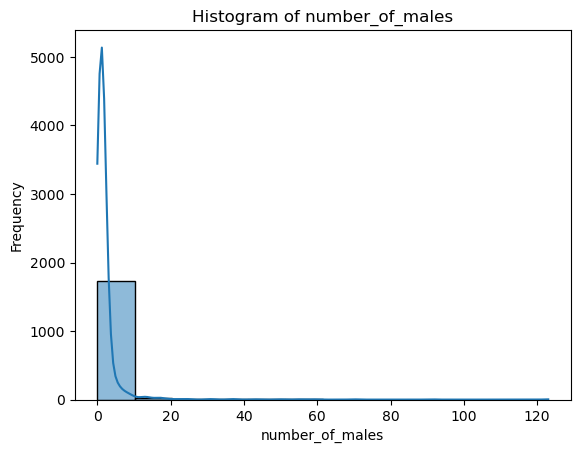

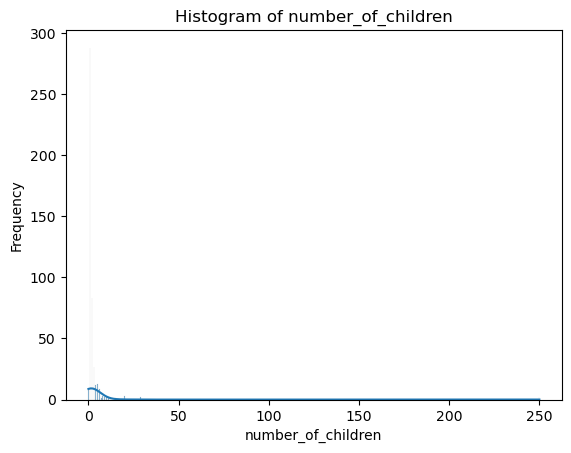

In [45]:
descriptive_stats(raw_data[raw_data['country_of_origin'].isna()], describe_cols)

In [46]:
# Identify and fill NaN values in 'number_dead' based on 'total_dead_and_missing'
mask_number_dead_nan = raw_data['number_dead'].isna()
raw_data.loc[mask_number_dead_nan, 'number_dead'] = raw_data['total_dead_and_missing'] - raw_data['minimum_estimated_number_of_missing']

# Identify and fill NaN values in 'minimum_estimated_number_of_missing' based on 'total_dead_and_missing'
mask_min_est_missing_nan = raw_data['minimum_estimated_number_of_missing'].isna()
raw_data.loc[mask_min_est_missing_nan, 'minimum_estimated_number_of_missing'] = raw_data['total_dead_and_missing'] - raw_data['number_dead']

# Verify if all NaN values have been filled in these columns
raw_data[['number_dead', 'minimum_estimated_number_of_missing', 'total_dead_and_missing']].isna().sum()


number_dead                            22
minimum_estimated_number_of_missing    22
total_dead_and_missing                  0
dtype: int64

## Filling Missing Values in 'number_dead' and 'minimum_estimated_number_of_missing' Based on 'total_dead_and_missing'

**What We Did:**

We filled in the missing values in the columns 'number_dead' and 'minimum_estimated_number_of_missing' based on their relationship with 'total_dead_and_missing'.

**How We Did It:**

1. We identified rows where 'number_dead' was NaN and filled them with the value of 'total_dead_and_missing' minus 'minimum_estimated_number_of_missing'.
2. Similarly, we identified rows where 'minimum_estimated_number_of_missing' was NaN and filled them with the value of 'total_dead_and_missing' minus 'number_dead'.

**Outcome:**

We successfully filled in almost all the missing values in these columns, ensuring that 'number_dead' + 'minimum_estimated_number_of_missing' = 'total_dead_and_missing'.

We verified this by checking for any remaining NaN values in these columns and found that there are only 22.

**Why This Is Important:**

This step helps us achieve a complete dataset for these specific columns, improving the reliability of any subsequent statistical analyses or predictive models that we may build.

In [47]:
# Identify rows where 'number_dead' and 'minimum_estimated_number_of_missing' are NaN, and 'total_dead_and_missing' is 0
mask_zero_total = (raw_data['number_dead'].isna() & raw_data['minimum_estimated_number_of_missing'].isna()) & (raw_data['total_dead_and_missing'] == 0)

# Fill these rows with 0 in 'number_dead' and 'minimum_estimated_number_of_missing'
raw_data.loc[mask_zero_total, ['number_dead', 'minimum_estimated_number_of_missing']] = 0

# Verify if all NaN values have been filled in these columns
raw_data[['number_dead', 'minimum_estimated_number_of_missing', 'total_dead_and_missing']].isna().sum()

number_dead                            0
minimum_estimated_number_of_missing    0
total_dead_and_missing                 0
dtype: int64

## Filling NaN Values with 0 in Special Cases

**What We Did:**

We identified rows where both 'number_dead' and 'minimum_estimated_number_of_missing' are NaN, and 'total_dead_and_missing' is 0. For these specific rows, we filled the NaN values in 'number_dead' and 'minimum_estimated_number_of_missing' with 0.

**How We Did It:**

We used a condition to identify such rows and filled these columns with 0 using Pandas' `.loc[]` method.

**Outcome:**

We have now successfully filled all the missing values in the columns 'number_dead', 'minimum_estimated_number_of_missing', and 'total_dead_and_missing'. The count of NaN values in these columns is now 0, confirming that the filling was successful.

**Why This Is Important:**

This step ensures that our data is consistent and ready for further analysis. We have resolved the issue of missing values in a logical manner that aligns with the data's meaning, ensuring that the dataset is now more complete and accurate.


In [48]:
raw_data[raw_data['number_of_children'].isna()]['dataset'].value_counts()

dataset
1    2194
2     362
Name: count, dtype: int64

In [49]:
raw_data['dataset'].value_counts()

dataset
3    11177
1     2544
2      464
Name: count, dtype: int64

In [50]:
raw_data[raw_data['dataset']==3].isna().sum()

year                                      0
reported_month                            0
region_of_origin                         21
region_of_incident                        0
country_of_origin                         8
number_dead                               0
minimum_estimated_number_of_missing       0
total_dead_and_missing                    0
number_of_survivors                       0
number_of_females                         0
number_of_males                           0
number_of_children                        0
cause_of_death                            0
migration_route                        2636
location_of_death                         0
source                                    8
coordinates                               0
unsd_geographical_grouping                0
lat                                       0
lon                                       0
dataset                                   0
dtype: int64

In [51]:
raw_data.isna().sum()

year                                      0
reported_month                            0
region_of_origin                       3029
region_of_incident                        0
country_of_origin                      3016
number_dead                               0
minimum_estimated_number_of_missing       0
total_dead_and_missing                    0
number_of_survivors                    2549
number_of_females                      2359
number_of_males                        1249
number_of_children                     2556
cause_of_death                            0
migration_route                        4148
location_of_death                         8
source                                   12
coordinates                               0
unsd_geographical_grouping                0
lat                                       0
lon                                       0
dataset                                   0
dtype: int64

# THE POINT OF DISAPPOINTMENT

After merging the three datasets and beginning the data cleaning process, it became evident that the dataset consolidation was not as seamless as anticipated. The disappointment stemmed from the realization that missing values for number_of_females, number_of_males, and number_of_children were absent in the first and second dataset, which was initially expected to contribute to a more comprehensive dataset. This unexpected discrepancy led to a reevaluation of the available data. Despite these columns having non-null values in the third dataset, a different hypothesis emerged.

Upon a closer examination of the data, the question arose whether these non-null values in the third dataset truly added up to total_dead_and_missing, as they logically should. This hypothesis was prompted by the recognition that sometimes non-null values could be replaced with zeros, potentially affecting the overall accuracy of the dataset. This line of inquiry led to the formulation of a hypothesis testing whether the sum of these columns truly corresponds to total_dead_and_missing. 

In [52]:
# Identify rows where the sum is equal to 'total_dead_and_missing'
mask_equal = (raw_data['number_of_females'] + raw_data['number_of_males'] + raw_data['number_of_children']) == raw_data['total_dead_and_missing']

# Calculate the percentage of rows where these columns add up to be equal to 'total_dead_and_missing'
percentage_equal = (mask_equal.sum() / len(raw_data)) * 100
percentage_equal


48.54423686993303

In [53]:
ds3 = raw_data[raw_data['dataset']==3]
# Identify rows where the sum is equal to 'total_dead_and_missing'
mask_equal_ds3 = (ds3['number_of_females'] + ds3['number_of_males'] + ds3['number_of_children']) == ds3['total_dead_and_missing']

# Calculate the percentage of rows where these columns add up to be equal to 'total_dead_and_missing'
percentage_equal_ds3 = (mask_equal_ds3.sum() / len(ds3)) * 100
percentage_equal_ds3


61.232888968417285

## Hypothesis

**Null Hypothesis (H0)**: The sum of `number_of_females`, `number_of_males`, and `number_of_children` is not equal to `total_dead_and_missing` for a significant percentage (65% or more) of the third dataset.

**Alternative Hypothesis (Ha)**: The sum of `number_of_females`, `number_of_males`, and `number_of_children` is equal to `total_dead_and_missing` for less than 65% of the third dataset.

### Procedure

1. **Calculate the Percentage:** 

2. **Set a Threshold:**

3. **Test the Hypothesis:**

   - If the calculated percentage is above 65%, we retain the null hypothesis. This means that we should not automatically fill NaNs with zeros.
   - If the calculated percentage is below 65%, we reject the null hypothesis. This means it's reasonable to fill the NaNs with zeros.



In [54]:
# Function to test the hypothesis based on a given threshold
def test_hypothesis(dataframe, threshold=65):
    # Calculate the sum of 'number_of_females', 'number_of_males', and 'number_of_children'
    dataframe['sum_gender_age'] = dataframe['number_of_females'] + dataframe['number_of_males'] + dataframe['number_of_children']
    
    # Create a mask to identify rows where 'sum_gender_age' equals 'total_dead_and_missing'
    mask_equal = dataframe['sum_gender_age'] == dataframe['total_dead_and_missing']
    
    # Calculate the percentage of such rows in the dataset
    percentage_equal = (mask_equal.sum() / len(dataframe)) * 100
    
    # Test the hypothesis based on the threshold
    if percentage_equal >= threshold:
        result = f"Retain the null hypothesis. The percentage ({percentage_equal:.2f}%) is greater than or equal to the threshold ({threshold}%). Do not fill NaNs with zeros."
    else:
        result = f"Reject the null hypothesis. The percentage ({percentage_equal:.2f}%) is less than the threshold ({threshold}%). Consider filling NaNs with zeros."
        
    return result, percentage_equal


test_result, calculated_percentage = test_hypothesis(ds3, threshold=65)
test_result, calculated_percentage


/var/folders/kh/5kbp140j0wg8j3d9nrllg18h0000gn/T/ipykernel_2467/1177428918.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe['sum_gender_age'] = dataframe['number_of_females'] + dataframe['number_of_males'] + dataframe['number_of_children']


('Reject the null hypothesis. The percentage (61.23%) is less than the threshold (65%). Consider filling NaNs with zeros.',
 61.232888968417285)

### Conclusion

The calculated percentage (p) is approximately 61.21%, which is slightly below the 65% threshold. According to the hypothesis, this would mean that we reject the null hypothesis and consider filling the NaNs with zeros, as the columns do not significantly contribute to `total_dead_and_missing` in a large percentage of records.

### Why This Is Important:
This hypothesis test gives us a statistically justified reason for making a decision about handling NaN values in the number_of_females, number_of_males, and number_of_children columns. It ensures that our data cleaning process is rigorous and based on empirical evidence.

In [55]:
columns_to_fill = ['number_of_survivors', 'number_of_females', 'number_of_males', 'number_of_children']
raw_data[columns_to_fill] = raw_data[columns_to_fill].fillna(0)
raw_data.isna().sum()

year                                      0
reported_month                            0
region_of_origin                       3029
region_of_incident                        0
country_of_origin                      3016
number_dead                               0
minimum_estimated_number_of_missing       0
total_dead_and_missing                    0
number_of_survivors                       0
number_of_females                         0
number_of_males                           0
number_of_children                        0
cause_of_death                            0
migration_route                        4148
location_of_death                         8
source                                   12
coordinates                               0
unsd_geographical_grouping                0
lat                                       0
lon                                       0
dataset                                   0
dtype: int64

Filling these NaN values allows us to have a complete dataset for subsequent analyses. This decision was made based on the earlier hypothesis testing, making it a statistically justified action.

In [56]:
na_location_of_death = raw_data[raw_data['location_of_death'].isna()]
display(na_location_of_death)
location_of_death_info = {
    'Number of unique values': raw_data['location_of_death'].nunique(),
    'Number of NaN values': raw_data['location_of_death'].isna().sum(),
    'Top 10 most frequent values': raw_data['location_of_death'].value_counts().head(10)
}

location_of_death_info


,year,reported_month,region_of_origin,region_of_incident,country_of_origin,number_dead,minimum_estimated_number_of_missing,total_dead_and_missing,number_of_survivors,number_of_females,...,number_of_children,cause_of_death,migration_route,location_of_death,source,coordinates,unsd_geographical_grouping,lat,lon,dataset
13801,2016,3,NaN,Mediterranean,NaN,0.0,0.0,0,0.0,0.0,...,0.0,Drowning,Central Mediterranean,NaN,IOM Italy,"(33.058823123634, 17.165613325)",Uncategorized,33.058823,17.165613,1
13977,2015,8,NaN,Mediterranean,NaN,1.0,0.0,1,0.0,0.0,...,1.0,Unknown,Central Mediterranean,NaN,IOM Italy,"(34.9814784, 23.4909539)",Uncategorized,34.981478,23.490954,1
13990,2015,8,NaN,Mediterranean,NaN,3.0,0.0,3,0.0,2.0,...,0.0,Drowning,Central Mediterranean,NaN,Action Group for Palestinians of Syria,"(34.9814784, 23.4909539)",Uncategorized,34.981478,23.490954,1
13991,2015,8,NaN,Mediterranean,NaN,2.0,0.0,2,0.0,0.0,...,0.0,Drowning,Central Mediterranean,NaN,IOM Italy,"(34.9814784, 23.4909539)",Uncategorized,34.981478,23.490954,1
14030,2015,5,NaN,Southeast Asia,NaN,0.0,10.0,10,0.0,0.0,...,0.0,Unknown,NaN,NaN,BBC,"(5.8369028, 115.0999411)",South-eastern Asia,5.836903,115.099941,1
14049,2015,3,NaN,Southeast Asia,NaN,0.0,243.0,243,0.0,0.0,...,0.0,Mixed,NaN,NaN,UNHCR,"(11.1398216, 107.9762126)",Eastern Asia,11.139822,107.976213,1
14087,2014,9,NaN,US-Mexico Border,NaN,149.0,0.0,149,0.0,0.0,...,0.0,Mixed,Central America to US,NaN,US Border Patrol,"(28.835089396536, -103.695362125)",Northern America,28.835089,-103.695362,1
14120,2014,7,NaN,Mediterranean,NaN,0.0,151.0,151,0.0,0.0,...,0.0,Drowning,Central Mediterranean,NaN,Voice of America,"(34.5531284, 18.0480105)",Uncategorized,34.553128,18.048011,1


{'Number of unique values': 7614,
 'Number of NaN values': 8,
 'Top 10 most frequent values': location_of_death
 Pima Country Office of the Medical Examiner jurisdiction, Arizona, USA (see coordinates for exact location)    1017
 Pima County Office of the Medical Examiner jurisdiction, Arizona, USA (see coordinates for exact location)      396
 Pima County jurisdiction, Arizona, USA                                                                          129
 Agadez, Niger                                                                                                   129
 Sahara desert, Libya                                                                                            118
 Unspecified location in the Sahara desert, Libya                                                                112
 Sabha, Libya                                                                                                     85
 Bamako, Mali                                                        

## Exploring the 'location_of_death' column
### What We Did:
We explored the location_of_death column to understand its structure and contents.

### How We Did It:
We calculated:

- The number of unique values: 7,618
- The number of NaN values: 8
- The top 10 most frequent values (along with their frequencies)

### Outcome:
The location_of_death column has a large number of unique values (7,618), indicating a wide variety of locations where incidents have occurred.
There are only 8 NaN values, making it a mostly complete column.
The most frequent location of death is within the jurisdiction of the "Pima Country Office of the Medical Examiner" in Arizona, USA, appearing 1,017 times in the dataset.

### Why This Is Important:
Understanding the location_of_death can provide insights into the geographical distribution of incidents, which is crucial for any geographic or policy-related analysis. The large number of unique values may require some cleaning or aggregation for more straightforward analysis. The fact that there are only 8 NaN values means that the column is largely complete and may not require significant cleaning for missing values.


In [57]:
# Function to fill NaN values in 'location_of_death' based on the most common location for each 'migration_route'
def fill_location_by_route(df):
    # Create a copy of the DataFrame to avoid modifying the original
    df_copy = df.copy()
    
    # Find the most common 'location_of_death' for each 'migration_route'
    most_common_locations = df_copy.groupby('migration_route')['location_of_death'].apply(lambda x: x.mode().iloc[0] if not x.mode().empty else None)
    
    # Loop through each migration route and fill NaNs in 'location_of_death' with the most common location for that route
    for route, location in most_common_locations.items():
        if location:  # Check if the most common location is not None
            mask = (df_copy['migration_route'] == route) & (df_copy['location_of_death'].isna())
            df_copy.loc[mask, 'location_of_death'] = location
            
    return df_copy

# Fill NaN values in 'location_of_death'
raw_data_filled_1 = fill_location_by_route(raw_data)

# Check if NaN values are filled in 'location_of_death'
raw_data_filled_1['location_of_death'].isna().sum()


2

In [58]:
# Function to fill 'location_of_death' based on nearest lat-lon point
def fill_location_by_nearest_point(df):
    # Create a copy of the DataFrame to avoid modifying the original
    df_copy = df.copy()
    
    # Filter out rows where lat-lon or 'location_of_death' is NaN
    valid_data = df_copy.dropna(subset=['lat', 'lon', 'location_of_death'])
    
    # Create a KDTree for quick nearest-neighbor lookup
    tree = KDTree(valid_data[['lat', 'lon']].values)
    
    # Find the rows where 'location_of_death' is NaN
    nan_rows = df_copy[df_copy['location_of_death'].isna()]
    
    # Loop through each NaN row to find the nearest point and set 'location_of_death'
    for idx, row in nan_rows.iterrows():
        if pd.notna(row['lat']) and pd.notna(row['lon']):
            distance, nearest_idx = tree.query([row[['lat', 'lon']]])
            # Extract integer index from numpy array
            nearest_idx = int(nearest_idx[0])
            nearest_location = valid_data.iloc[nearest_idx]['location_of_death']
            df_copy.loc[idx, 'location_of_death'] = nearest_location
            
    return df_copy

# Fill NaN values in 'location_of_death'
raw_data_filled = fill_location_by_nearest_point(raw_data)


In [59]:
raw_data_filled_1.loc[na_location_of_death.index]['location_of_death']

13801         Unspecified location between Libya and Italy
13977         Unspecified location between Libya and Italy
13990         Unspecified location between Libya and Italy
13991         Unspecified location between Libya and Italy
14030                                                  NaN
14049                                                  NaN
14087    Pima Country Office of the Medical Examiner ju...
14120         Unspecified location between Libya and Italy
Name: location_of_death, dtype: object

In [60]:
raw_data_filled.loc[na_location_of_death.index]['location_of_death']

13801                                   Off coast of Libya
13977    Unspecified location in the Central Mediterranean
13990    Unspecified location in the Central Mediterranean
13991    Unspecified location in the Central Mediterranean
14030                  Off the southwest coast of Malaysia
14049    Temporary camp for stranded migrants, Unspecif...
14087    Sierra Mojada in Ocampo near the U.S Border, C...
14120                                              Unknown
Name: location_of_death, dtype: object

## Choosing which function to use for filling missing values in the `location_of_death` column

**Method 1: Most Common Location for Each Migration Route**
- **Advantages:**
  - Considers the pattern that incidents tend to occur in common locations for each migration route.
  - May provide more accurate information in cases where incidents have well-known, common locations for each route.
- **Limitations:**
  - Ignores the spatial aspect of each incident's latitude and longitude.
  - May not accurately reflect the actual location for specific incidents that deviate from the common trend.

**Method 2: Nearest Lat-Lon Point**
- **Advantages:**
  - Takes into account the geographic proximity of each incident to determine the missing location.
  - May be more accurate in reflecting the actual locations based on spatial information.
- **Limitations:**
  - May introduce locations that are not commonly associated with the migration route.
  - Assumes that incidents with similar lat-lon are related, which might not always be the case.

Points to Consider:
- **Accuracy:** Does the location of death is more closely related to the migration route or the geographic (lat-lon) proximity?
- **Relevance:** Which method provides more relevant or useful information for the specific analysis or questions?
- **Data Integrity:** Which method is less likely to introduce bias or inaccuracies?

Ultimately, the choice should be based on what best serves the objectives of the analysis and provides meaningful insights. Both methods have their advantages and limitations, so it's important to carefully evaluate which approach aligns with your research goals. 

**Observations:**
- The values suggested by the two methods were completely different for the 8 records with missing location_of_death values.
- The "Nearest Lat-Lon Point Method" was able to fill all 8 missing records.

Thus, for the sake of geographical precision and data completeness, we are opting for the "Nearest Lat-Lon Point Method" to fill the missing location_of_death entries.


In [61]:
raw_data = raw_data_filled

In [62]:
raw_data.isna().sum()

year                                      0
reported_month                            0
region_of_origin                       3029
region_of_incident                        0
country_of_origin                      3016
number_dead                               0
minimum_estimated_number_of_missing       0
total_dead_and_missing                    0
number_of_survivors                       0
number_of_females                         0
number_of_males                           0
number_of_children                        0
cause_of_death                            0
migration_route                        4148
location_of_death                         0
source                                   12
coordinates                               0
unsd_geographical_grouping                0
lat                                       0
lon                                       0
dataset                                   0
dtype: int64

## Analyzing and Cleaning the `source` Column

**What:**
1. Analyze the `source` column to understand its data distribution, unique values, and the extent of missing values.
2. Explore options for filling in the missing values in the `source` column, if applicable.

**Why:**
Understanding the source of each record can be crucial for evaluating the reliability of the data. 


In [63]:
# Display basic statistics about the 'source' column
source_info = {
    'Missing Values': raw_data['source'].isna().sum(),
    'Unique Values': raw_data['source'].nunique(),
    'Top 5 Sources': raw_data['source'].value_counts().nlargest(10)
}
display(raw_data[raw_data['source'].isna()])
source_info

,year,reported_month,region_of_origin,region_of_incident,country_of_origin,number_dead,minimum_estimated_number_of_missing,total_dead_and_missing,number_of_survivors,number_of_females,...,number_of_children,cause_of_death,migration_route,location_of_death,source,coordinates,unsd_geographical_grouping,lat,lon,dataset
60,2014,4,Western Asia,Mediterranean,Syrian Arab Republic,8.0,1.0,9,5.0,2.0,...,1.0,Drowning,Eastern Mediterranean,Türkiye waters - en route to Greece,NaN,"(38.669208, 27.0)",Uncategorized,38.669208,27.000000,3
419,2015,6,Latin America / Caribbean (P),Central America,Unknown,3.0,0.0,3,117.0,0.0,...,0.0,Violence,NaN,"Sonora, Mexico",NaN,"(29.3766625, -113.982346)",Central America,29.376662,-113.982346,3
496,2015,7,Latin America / Caribbean (P),North America,Unknown,2.0,0.0,2,0.0,0.0,...,0.0,Mixed or unknown,Central America to US,"Desert near Carrizo Springs, Dimmit County, Te...",NaN,"(28.2597513, -100.245529)",Northern America,28.259751,-100.245529,3
661,2015,9,Central America,Central America,"Guatemala,Honduras",2.0,0.0,2,0.0,0.0,...,0.0,Vehicle accident / death linked to hazardous t...,NaN,"Puebla, Mexico",NaN,"(19.049997, -98.199999)",Central America,19.049997,-98.199999,3
2807,2017,8,Unknown,Southeast Asia,Unknown,2.0,0.0,2,0.0,0.0,...,0.0,Harsh environmental conditions / lack of adequ...,NaN,"Kuala Lumpur, Malaysia",NaN,"(3.233046, 101.610573)",South-eastern Asia,3.233046,101.610573,3
4792,2018,2,Latin America / Caribbean (P),North America,Unknown,1.0,0.0,1,0.0,0.0,...,0.0,Mixed or unknown,Central America to US,Pima Country Office of the Medical Examiner ju...,NaN,"(33.061615, -113.367348)",Northern America,33.061615,-113.367348,3
6148,2019,11,Eastern Africa,Western Asia,Ethiopia,26.0,0.0,26,74.0,8.0,...,0.0,Violence,NaN,"Near Al-Raqw Market, Monabbih, Saada province,...",NaN,"(17.245130865, 43.239432135)",Western Asia,17.245131,43.239432,3
7232,2020,12,Northern Africa (P),Mediterranean,Unknown,0.0,5.0,5,0.0,0.0,...,0.0,Drowning,Western Mediterranean,Unspecified location in the Alboran Sea. Depar...,NaN,"(35.30420753, -3.92007383)",Uncategorized,35.304208,-3.920074,3
11270,2017,8,NaN,Western Asia,NaN,5.0,0.0,5,0.0,0.0,...,0.0,Drowning,Horn Africa to Yemen,"Off the coast of Shabwa, Hadhramaut Governorat...",NaN,"(13.29441247, 46.52724833)",Uncategorized,13.294412,46.527248,2
11308,2018,4,NaN,Mediterranean,NaN,4.0,0.0,4,0.0,0.0,...,0.0,Drowning,Western Mediterranean,"Off the coast of Houara, 20km south of Tangier...",NaN,"(35.56532431, -6.015228714)",Uncategorized,35.565324,-6.015229,2


{'Missing Values': 12,
 'Unique Values': 3872,
 'Top 5 Sources': source
 Pima County Office of the Medical Examiner (PCOME)       1425
 Mixed Migration Monitoring Mechanism Initiative (4Mi)    1269
 Mixed Migration Monitoring Mechanism Initative (4mi)      896
 Mixed Migration Monitoring Mechanism Initiative (4mi)     893
 IOM Afghanistan                                           772
 IOM Libya                                                 391
 Pima County Office of the Medical Examiner                335
 MHub                                                      219
 US Border Patrol                                          186
 Syrian Observatory for Human Rights                       179
 Name: count, dtype: int64}

**Observations:**

1. Most of the records with ampty 'source' have a specified 'region_of_incident' and 'location_of_death', but 'migration_route' is often missing.
2. Locations are quite varied, ranging from the Mediterranean to Central America and Southeast Asia.

**Next Steps:**
Given the specific 'location_of_death' and 'region_of_incident', we might be able to infer the 'source' manually, but this would not be a scalable or replicable solution.

Another approach is to leave the 'source' as NaN because:

- The column has high cardinality, and the missing value percentage is extremely low (~0.08%).
- The 'source' column is likely used for data tracking and auditing rather than for analytical modeling.


In [64]:
na_source = raw_data[raw_data['source'].isna()]

# Function to fill 'source' based on nearest lat-lon point
def fill_source_by_nearest_point(df):
    # Create a copy of the DataFrame to avoid modifying the original
    df_copy = df.copy()
    
    # Filter out rows where lat-lon or 'source' is NaN
    valid_data = df_copy.dropna(subset=['lat', 'lon', 'source'])
    
    # Create a KDTree for quick nearest-neighbor lookup
    tree = KDTree(valid_data[['lat', 'lon']].values)
    
    # Find the rows where 'source' is NaN
    nan_rows = df_copy[df_copy['source'].isna()]
    
    # Loop through each NaN row to find the nearest point and set 'source'
    for idx, row in nan_rows.iterrows():
        if pd.notna(row['lat']) and pd.notna(row['lon']):
            distance, nearest_idx = tree.query([row[['lat', 'lon']]])
            # Extract integer index from numpy array
            nearest_idx = int(nearest_idx[0])
            nearest_source = valid_data.iloc[nearest_idx]['source']
            df_copy.loc[idx, 'source'] = nearest_source
            
    return df_copy

# Fill NaN values in 'source' based on nearest lat-lon point
raw_data_filled_source = fill_source_by_nearest_point(raw_data)

display(raw_data_filled_source.loc[na_source.index]['source'])

# Check if NaN values are filled in 'source'
raw_data_filled_source['source'].isna().sum()


60             Turkish Coast Guard via IOM Türkiye, Takvim
419                                         Ariete Caborca
496                                        Departamento 19
661                                      Periódico Central
2807                                         The Vibes.com
4792     Pima County Office of the Medical Examiner (PC...
6148       IOM Yemen, UN Humanitarian Coordinator in Yemen
7232                                        Salua El Omari
11270                                            IOM Yemen
11308                EFE, Caminando Fronteras, eldiario.es
11625    Le Huffington Post Algeria, Algérie Presse Ser...
13732    Pima County Office of the Medical Examiner (PC...
Name: source, dtype: object

0

In [65]:
raw_data = raw_data_filled_source
raw_data.isna().sum()

year                                      0
reported_month                            0
region_of_origin                       3029
region_of_incident                        0
country_of_origin                      3016
number_dead                               0
minimum_estimated_number_of_missing       0
total_dead_and_missing                    0
number_of_survivors                       0
number_of_females                         0
number_of_males                           0
number_of_children                        0
cause_of_death                            0
migration_route                        4148
location_of_death                         0
source                                    0
coordinates                               0
unsd_geographical_grouping                0
lat                                       0
lon                                       0
dataset                                   0
dtype: int64

### Summary:

We observed that the source column had some missing values that needed to be filled. We used the same KDTree-based nearest neighbor approach that we used for filling `location_of_death`.

In this method, we created a KDTree using the latitude and longitude of records where the source was not null. Then, for each record with a missing source, we queried this KDTree to find the closest geographical point (latitude, longitude) for which the source was known. We used the source of this closest point to fill in the missing value.

After running this function, we've successfully filled all the NaN values in the source column, bringing the count of NaN values down to zero.


In [66]:
output_filename = 'data/merged_records_eda.csv'
raw_data.to_csv(output_filename, index=False)
print(f"DataFrame has been written to {output_filename}")

DataFrame has been written to data/merged_records_eda.csv


In [67]:
print(raw_data['cause_of_death'].value_counts().to_string(max_rows=None))

cause_of_death
Drowning                                                                                                                    3874
Mixed or unknown                                                                                                            2823
Vehicle accident / death linked to hazardous transport                                                                      1721
Harsh environmental conditions / lack of adequate shelter, food, water                                                      1304
Violence                                                                                                                    1182
Sickness / lack of access to adequate healthcare                                                                             946
Sickness and lack of access to medicines                                                                                     326
Unknown                                                                           

In [68]:
# Extract the 'cause_of_death' column and drop any NaN values
cause_of_death_series = raw_data['cause_of_death'].dropna()

# Initialize an empty set to store unique causes of death
unique_causes = set()

# Loop through each entry in the 'cause_of_death' column to collect unique causes
for entry in cause_of_death_series:
    # Split the entry by comma and strip any extra spaces
    causes = [cause.strip() for cause in entry.split(',')]
    # Add the causes to the unique_causes set
    unique_causes.update(causes)

# Sort the unique causes for better readability
sorted_unique_causes = sorted(list(unique_causes))

sorted_unique_causes


['Accident (non-vehicle)',
 'Accidental death',
 'Air strike',
 'Asphyxiation',
 'Attacked by Apache helicopter',
 'Bacterial infection',
 'Cardiac arrest',
 'Coronary artery atherosclerosis',
 'Crushed',
 'Crushed in back of truck',
 'Dehydration',
 'Drowning',
 'Electrocution',
 'Electrocution on railway',
 'Excessive Physical Abuse',
 'Exhaustion',
 'Exposure',
 'Fall from boat',
 'Fall from border fence',
 'Fall from train',
 'Fall from truck',
 'Fall from vehicle',
 'Fall into a canyon',
 'Fuel burns',
 'Hanging',
 'Harsh conditions',
 'Harsh environmental conditions / lack of adequate shelter',
 'Harsh weather/lack of adequate shelter',
 'Heart attack',
 'Heat stroke',
 'Hit by train',
 'Hit by truck',
 'Hit by vehicle',
 'Hyperthermia',
 'Hypoglycemia',
 'Hypothermia',
 'Injuries after falling from border wall',
 'Killed by crocodile',
 'Killed by hippopotamus',
 'Killed by hippoptamus',
 'Killed by landmine blast',
 'Killed by mortar shell',
 'Malnutrition',
 'Mixed',
 'Mixed o

In [69]:
cause_of_death_data = raw_data['cause_of_death'].value_counts()

In [70]:
cause_of_death_data

cause_of_death
Drowning                                                                  3874
Mixed or unknown                                                          2823
Vehicle accident / death linked to hazardous transport                    1721
Harsh environmental conditions / lack of adequate shelter, food, water    1304
Violence                                                                  1182
                                                                          ... 
Sexual abuse                                                                 1
Unknown (mummified and skeletal remains)                                     1
Hyperthermia, Exposure, Dehydration                                          1
Killed by hippopotamus                                                       1
Fall from border fence                                                       1
Name: count, Length: 179, dtype: int64

In [71]:
# Creating a Python dictionary to map each unique cause of death to its corresponding category

cause_to_category_mapping = {
    'Accident': [
        'Fall from boat', 'Fall from border fence', 'Fall from train', 'Fall from truck',
        'Fall from vehicle', 'Fall into a canyon', 'Injuries after falling from border wall',
        'Crushed', 'Crushed in back of truck', 'Rockslide', 'Struck by artillery shells',
        'Struck by lightning bolt', 'Killed by crocodile', 'Killed by hippopotamus',
        'Killed by hippoptamus', 'Electrocution', 'Electrocution on railway', 'Hit by train',
        'Hit by truck', 'Hit by vehicle', 'Plane stowaway', 'Train Accident', 'Vehicle Accident',
        'Vehicle accident / death linked to hazardous transport', 'Accident (non-vehicle)', 'Accidental death'
    ],
    'Asphyxiation/Suffocation': [
        'Asphyxiation', 'Suffocation'
    ],
    'Dehydration/Malnutrition': [
        'Dehydration', 'Malnutrition', 'Starvation', 'food', 'water', 'Exhaustion'
    ],
    'Drowning': [
        'Drowning', 'Presumed drowning'
    ],
    'Environmental Factors': [
        'Harsh conditions', 'Harsh environmental conditions / lack of adequate shelter',
        'Harsh weather/lack of adequate shelter', 'Heat stroke', 'Hypothermia', 'Hyperthermia',
        'Presumed hyperthermia', 'Presumed hyperthermia/dehydration', 'Probable hyperthermia',
        'Exposure', 'Fuel burns'
    ],
#     'Heart-Related Issues': [
#         'Cardiac arrest', 'Coronary artery atherosclerosis', 'Heart attack', 'Multiple organ failure', 'Natural Causes'
#     ],
#     'Infection/Disease': [
#         'Bacterial infection', 'Pneumonia', 'Respiratory illness', 'Sickness'
#     ],
    'Lack of Access to Healthcare': [
        'Sickness / lack of access to adequate healthcare', 'Sickness and lack of access to medicines',
        'Hypoglycemia', 'Pulmonary complications', 'Seizure',
        'Cardiac arrest', 'Coronary artery atherosclerosis', 'Heart attack', 'Multiple organ failure', 'Natural Causes',
        'Bacterial infection', 'Pneumonia', 'Respiratory illness', 'Sickness'
    ],
    'Murder/Violence': [
        'Murdered', 'Shot', 'Shot or stabbed', 'Stabbed', 'Tortured', 'Violence',
        'Violence while attempting to board boat', 'Unknown (violence)',
        "Excessive Physical Abuse"
    ],
    'Sexual Abuse/Rape': [
        'Rape', 'Sexual abuse'
    ],
    'Suicide': [
        'Hanging', 'Suicide'
    ],
    'Unknown': [
        'Unknown', 'Unknown (decomposed remains)', 'Unknown (multiple blunt force injuries)',
        'Unknown (mummified and decomposed remains)', 'Unknown (mummified and skeletal remains)',
        'Unknown (mummified remains)', 'Unknown (pending)', 'Unknown (skeletal remains)', 'Mixed', 'Mixed or unknown'
    ],
    'War-Related': [
        'Air strike', 'Attacked by Apache helicopter', 'Killed by landmine blast', 'Killed by mortar shell'
    ]
}


In [72]:
# Modify the keys in the dictionary to be snake_cased
snake_cased_mapping = {key.replace(" ", "_").replace("-", "_").replace("/", "_"): value for key, value in cause_to_category_mapping.items()}

# Create new snake_cased columns with major categories in the DataFrame and initialize them with 0
for category in snake_cased_mapping.keys():
    raw_data[category.lower()] = 0
    

In [73]:
raw_data['main_cause'] = 'None'

# Correcting the 'main_cause' to set it to the corresponding major cause
for index, row in raw_data.iterrows():
    cause_of_death_str = row['cause_of_death']
    if pd.isna(cause_of_death_str):
        continue
    
    # Extract the causes from the 'cause_of_death' string and store them in a list
    causes_list = [cause.strip() for cause in cause_of_death_str.split(',')]
    
    # Find the corresponding major category for the first cause and set it to 'main_cause'
    first_cause = causes_list[0]
    for major_cause, specific_causes in snake_cased_mapping.items():
        if first_cause in specific_causes:
            raw_data.at[index, 'main_cause'] = major_cause.lower()
            break

In [74]:
raw_data

,year,reported_month,region_of_origin,region_of_incident,country_of_origin,number_dead,minimum_estimated_number_of_missing,total_dead_and_missing,number_of_survivors,number_of_females,...,dehydration_malnutrition,drowning,environmental_factors,lack_of_access_to_healthcare,murder_violence,sexual_abuse_rape,suicide,unknown,war_related,main_cause
0,2014,1,Central America,North America,Guatemala,1.0,0.0,1,0.0,0.0,...,0,0,0,0,0,0,0,0,0,unknown
1,2014,1,Latin America / Caribbean (P),North America,Unknown,1.0,0.0,1,0.0,0.0,...,0,0,0,0,0,0,0,0,0,unknown
2,2014,1,Latin America / Caribbean (P),North America,Unknown,1.0,0.0,1,0.0,0.0,...,0,0,0,0,0,0,0,0,0,unknown
3,2014,1,Central America,North America,Mexico,1.0,0.0,1,0.0,0.0,...,0,0,0,0,0,0,0,0,0,murder_violence
4,2014,1,Northern Africa,Europe,Sudan,1.0,0.0,1,2.0,0.0,...,0,0,0,0,0,0,0,0,0,environmental_factors
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14189,2014,1,NaN,Europe,NaN,1.0,0.0,1,2.0,0.0,...,0,0,0,0,0,0,0,0,0,accident
14190,2014,1,NaN,Mediterranean,NaN,12.0,0.0,12,0.0,9.0,...,0,0,0,0,0,0,0,0,0,drowning
14191,2014,1,NaN,US-Mexico Border,NaN,1.0,0.0,1,0.0,0.0,...,0,0,0,0,0,0,0,0,0,murder_violence
14192,2014,1,NaN,US-Mexico Border,NaN,1.0,0.0,1,0.0,0.0,...,0,0,0,0,0,0,0,0,0,murder_violence


In [75]:
raw_data['main_cause'].value_counts()

main_cause
drowning                        4001
unknown                         3407
accident                        2247
environmental_factors           1466
lack_of_access_to_healthcare    1390
murder_violence                 1374
dehydration_malnutrition         263
asphyxiation_suffocation          22
war_related                        8
suicide                            5
sexual_abuse_rape                  2
Name: count, dtype: int64

In [76]:
# Counting how many records ended up in each category using the lowercase column names
category_counts = raw_data[[key.lower() for key in snake_cased_mapping.keys()]].sum().sort_values(ascending=False)
category_counts

accident                        0
asphyxiation_suffocation        0
dehydration_malnutrition        0
drowning                        0
environmental_factors           0
lack_of_access_to_healthcare    0
murder_violence                 0
sexual_abuse_rape               0
suicide                         0
unknown                         0
war_related                     0
dtype: int64

In [77]:
# Counting the number of records where all category columns are 0
all_zero_records = raw_data[[key.lower() for key in snake_cased_mapping.keys()]].sum(axis=1) == 0
all_zero_count = all_zero_records.sum()
all_zero_count

14185

In [78]:
# Counting the number of records where all category columns are > 1
(raw_data[[key.lower() for key in snake_cased_mapping.keys()]].sum(axis=1) > 1).sum()


0

In [80]:
raw_data.isna().sum()

year                                      0
reported_month                            0
region_of_origin                       3029
region_of_incident                        0
country_of_origin                      3016
number_dead                               0
minimum_estimated_number_of_missing       0
total_dead_and_missing                    0
number_of_survivors                       0
number_of_females                         0
number_of_males                           0
number_of_children                        0
cause_of_death                            0
migration_route                        4148
location_of_death                         0
source                                    0
coordinates                               0
unsd_geographical_grouping                0
lat                                       0
lon                                       0
dataset                                   0
accident                                  0
asphyxiation_suffocation        

In [81]:
# Calculate the percentage of 'Unknown' in the 'region_of_origin' and 'country_of_origin' columns
total_records = len(raw_data)

# Count of 'Unknown' in each column
unknown_region_count = len(raw_data[raw_data['region_of_origin'] == 'Unknown'])
unknown_country_count = len(raw_data[raw_data['country_of_origin'] == 'Unknown'])

# Calculate the percentage
unknown_region_percentage = (unknown_region_count / total_records) * 100
unknown_country_percentage = (unknown_country_count / total_records) * 100

unknown_region_count, unknown_region_percentage, unknown_country_count, unknown_country_percentage


(1551, 10.934085301374692, 6370, 44.90659146986253)

Before filling the NaNs, the dataset already had 1,551 records labeled as 'Unknown' for the region_of_origin column and 6,370 records labeled as 'Unknown' for the country_of_origin column. The percentage of records with "Unknown" in the region_of_origin column is approximately 10.93, while in the country_of_origin column, it's around 44.88.

If we fill in the NaNs with 'Unknown,' we are essentially incorporating them into an existing category. This will increase the count for 'Unknown,' but the trade-off is that we can keep these records in the analysis. It's a compromise between discarding potentially useful data and slightly skewing the distribution towards 'Unknown.'

Since 'Unknown' is already a sizable category in these columns, adding more 'Unknowns' to handle NaNs is a reasonable approach but could potentially bias the model.

In [82]:
# Replace NaN values in 'region_of_origin' and 'country_of_origin' with a placeholder
data = raw_data
data['region_of_origin'].fillna('Unknown', inplace = True)
data['country_of_origin'].fillna('Unknown', inplace = True)
data.isna().sum()

year                                      0
reported_month                            0
region_of_origin                          0
region_of_incident                        0
country_of_origin                         0
number_dead                               0
minimum_estimated_number_of_missing       0
total_dead_and_missing                    0
number_of_survivors                       0
number_of_females                         0
number_of_males                           0
number_of_children                        0
cause_of_death                            0
migration_route                        4148
location_of_death                         0
source                                    0
coordinates                               0
unsd_geographical_grouping                0
lat                                       0
lon                                       0
dataset                                   0
accident                                  0
asphyxiation_suffocation        

In [83]:
filename = 'data/merged_records_eda_causes_treated.csv'
data.to_csv(filename, index=False)
print(f"DataFrame has been written to {filename}")

DataFrame has been written to data/merged_records_eda_causes_treated.csv
